## Scene text detection


## Description

#### Recognizing text in an image or scene has been a challenging task. We humans have no problem in detecting and understanding text in the real world, be it in any shape, size, orientation,colour. Along with this the image may have noise, blurring, low light etc.

#### So here we will try to solve the problem of a machine detecting text in an image (real world image with text) automatically.


## Business problem

#### Given an image if we are able to detect text in a scene with noise, it will open doors to further solutions for many other use cases like text recognition, text translation etc. This will help in reducing cost of manual labour in many sectors. For example from a phone camera we can detect text in a language and translate it into english or native language of the person, so that they can read address or names of roads in a foreign country for self-guidance. This can also be used in understanding advertisements.

#### One more use case is for ocr where a visually disabled person can leverage the technology advancements in text-to speech, along with text detection which can detect text in any format/font/orientation and convert it into sound and be understood by them. 

## Problem statement

#### Given a set of natural scene images having text in them, we have to detect text in it with different orientation, colors, sizes. The detected text will be bounded by a rotated bounding box rectacngle, which will try to enclose the text within it as accurately as possible. 

## Data source

[Synthtext dataset](https://www.robots.ox.ac.uk/~vgg/data/scenetext/)

### Annotations are given in a .mat file from which we will extract to dataframe

## Dataset overview

#### This data contains 858,750 synthetic scene-image files (.jpg) split into 200 directories out of which we have filtered 5860 images randomly for training. This number can be increased for even more intensive training.

#### Annotations of each image has image names, bounding box coordinates and text at word level.

#### Bounding box coordinates ->   word-level bounding-boxes for each image, represented by tensors of size 2x4xNWORDS_i, where:

*   the first dimension is 2 for x and y respectively,
*   the second dimension corresponds to the 4 points(clockwise starting from top-left), and
*   the third dimension of size NWORDS_i, corresponds to the number of words in the i_th image.

## Deep learning problem

#### Using a set of real world scene images with word level text in them annotated by a bounding box, we have to train a model which can detect text at multiple word level seperately given a new image.

#### We will use EAST text detector model's architecture to implement our own CNN based model along with opencv for image processing and gnd generating/drawing rotated bounding box.




In [25]:

import os
#os.environ["CUDA_VISIBLE_DEVICES"] = "-1"
import tensorflow as tf

%matplotlib inline
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (10.0, 8.0)
from matplotlib import image
import pandas as pd
import csv
from tqdm import tqdm
import seaborn as sns
import cv2
from shapely.geometry import Polygon
import ast

In [7]:

root_dir = ""
base_dir = root_dir + 'xtream/'


In [8]:
#reading dataframe
import pickle as pkl
with open(base_dir+'df_final.pkl','rb') as f:
    im_data= pkl.load(f)

In [26]:
import scipy.io
mat = scipy.io.loadmat(base_dir_dir+'gt.mat')
print(mat.keys())

dict_keys(['__header__', '__version__', '__globals__', 'charBB', 'wordBB', 'imnames', 'txt'])


In [27]:
# loading mat files to pandas - https://stackoverflow.com/a/67656830
mat = {k:v for k, v in mat.items() if k[0] != '_'}
df = pd.DataFrame({k: np.array(v).flatten() for k, v in mat.items()})

df.head()

,charBB,wordBB,imnames,txt
0,"[[[423.16126397044115, 439.60847342956527, 450...","[[[420.58957, 418.85016, 448.08478, 410.3094, ...",[8/ballet_106_0.jpg],"[Lines:\nI lost\nKevin , will ,..."
1,"[[[258.07380624978464, 275.38110202415453, 288...","[[[255.28821, 424.29144, 419.3614, 416.88367, ...",[8/ballet_106_1.jpg],"[with , Sender:\nBNR-..."
2,"[[[322.57886901392055, 336.9830334749271, 356....","[[[322.5814, 432.39447, 163.69196, 125.584595,...",[8/ballet_106_10.jpg],"[Fern , Mutch,, void , his , loony , it's ..."
3,"[[[258.02128800580556, 285.377491988315, 310.9...","[[[257.37372, 428.30585, 422.95227, 79.92147, ...",[8/ballet_106_100.jpg],"[Re: , reins\nneck , War\nfor\nthe, new..."
4,"[[[260.2081193865101, 269.6978659223447, 278.1...","[[[252.09306, 253.62775, 91.88652, 299.4024, 4...",[8/ballet_106_101.jpg],"[ Scott \nSender:, use , between ..."


In [28]:
df = df.drop(df.columns[[0]], axis=1) 

In [29]:
df

,wordBB,imnames,txt
0,"[[[420.58957, 418.85016, 448.08478, 410.3094, ...",[8/ballet_106_0.jpg],"[Lines:\nI lost\nKevin , will ,..."
1,"[[[255.28821, 424.29144, 419.3614, 416.88367, ...",[8/ballet_106_1.jpg],"[with , Sender:\nBNR-..."
2,"[[[322.5814, 432.39447, 163.69196, 125.584595,...",[8/ballet_106_10.jpg],"[Fern , Mutch,, void , his , loony , it's ..."
3,"[[[257.37372, 428.30585, 422.95227, 79.92147, ...",[8/ballet_106_100.jpg],"[Re: , reins\nneck , War\nfor\nthe, new..."
4,"[[[252.09306, 253.62775, 91.88652, 299.4024, 4...",[8/ballet_106_101.jpg],"[ Scott \nSender:, use , between ..."
...,...,...,...
858745,"[[[441.86517, 513.72986, 423.85715, 525.93054,...",[164/steel_75_95.jpg],"[have a , Lines: , stuff , out now ..."
858746,"[[[298.43454, 508.12146, 495.33154, 335.20538,...",[164/steel_75_96.jpg],"[the , vault., hoover, From: , the , this ..."
858747,"[[[277.35895, 314.80722, 511.6659, 443.8152, 3...",[164/steel_75_97.jpg],"[care has, Xref: , Your , 25 year ]"
858748,"[[[555.4985, 580.90125, 258.93762], [570.22723...",[164/steel_75_98.jpg],"[is a , >Chris]"


In [30]:
print(df['imnames'])

0           [8/ballet_106_0.jpg]
1           [8/ballet_106_1.jpg]
2          [8/ballet_106_10.jpg]
3         [8/ballet_106_100.jpg]
4         [8/ballet_106_101.jpg]
                   ...          
858745     [164/steel_75_95.jpg]
858746     [164/steel_75_96.jpg]
858747     [164/steel_75_97.jpg]
858748     [164/steel_75_98.jpg]
858749     [164/steel_75_99.jpg]
Name: imnames, Length: 858750, dtype: object


In [31]:
import random
def Rand(start, end, num):
    res = []
  
    for j in range(num):
        res.append(random.randint(start, end))
  
    return res
  
# Driver Code
num = 10
start = 20
end = 40
print(Rand(start, end, num))

[28, 24, 26, 25, 26, 29, 37, 36, 20, 21]


In [8]:
from time import time
from tqdm import tqdm
img_type={}
img_subtype={}
for i in range(1,201):
    img_type[str(i)]=0

    
final_data=[]

for i,row in tqdm(df[['wordBB','imnames','txt']].iterrows()):
    try:
        im=row['imnames'][0]
        cat= im.split('/')
        img_cat=cat[0]
        image_sub_cat=cat[1].split('_')
        image_num=image_sub_cat[1]
        if img_type[img_cat]==30:
            continue
        if img_type[img_cat]==0:
            img_subtype={}
            for i in Rand(1, 120, 40):
                img_subtype[str(i)]=0

    #     print(img_subtype)
        if img_type[img_cat] < 30:
    #         print('img cat: ',img_cat)
    #         print('img num: ', image_num)
            if image_num in img_subtype:
                #print(img_subtype)
                if img_subtype[image_num] < 5:
    #                 print('img num when inserting: ',image_num)

                    img_subtype[image_num]+=1
                    img_type[img_cat]+=1
                    final_data.append(str(im))
    except:
        pass

        
    

858750it [01:45, 8149.81it/s] 


In [9]:
len(final_data)
#so we have finally filtered 5860 datapoints

5860

In [10]:
a= [a.tolist()[0] for a in df['imnames']]

In [12]:
df['imnames']= [a.tolist()[0] for a in df['imnames']]

In [13]:
df['imnames']

0           8/ballet_106_0.jpg
1           8/ballet_106_1.jpg
2          8/ballet_106_10.jpg
3         8/ballet_106_100.jpg
4         8/ballet_106_101.jpg
                  ...         
858745     164/steel_75_95.jpg
858746     164/steel_75_96.jpg
858747     164/steel_75_97.jpg
858748     164/steel_75_98.jpg
858749     164/steel_75_99.jpg
Name: imnames, Length: 858750, dtype: object

In [14]:
df=df[df['imnames'].isin(final_data)]

In [15]:
df.shape

(5860, 3)

In [26]:
df.head(20)

,wordBB,imnames,txt
0,"[[[420.58957, 418.85016, 448.08478, 410.3094, ...",8/ballet_106_0.jpg,"[Lines:\nI lost\nKevin , will ,..."
1,"[[[255.28821, 424.29144, 419.3614, 416.88367, ...",8/ballet_106_1.jpg,"[with , Sender:\nBNR-..."
2,"[[[322.5814, 432.39447, 163.69196, 125.584595,...",8/ballet_106_10.jpg,"[Fern , Mutch,, void , his , loony , it's ..."
3,"[[[257.37372, 428.30585, 422.95227, 79.92147, ...",8/ballet_106_100.jpg,"[Re: , reins\nneck , War\nfor\nthe, new..."
4,"[[[252.09306, 253.62775, 91.88652, 299.4024, 4...",8/ballet_106_101.jpg,"[ Scott \nSender:, use , between ..."
219,"[[[251.66138, 252.90343, 299.42477, 127.14155,...",8/ballet_108_0.jpg,"[(301)-344-6255\norbiting unmanned, Lines: ..."
220,"[[[19.05286, 15.019035, 9.65118, 81.306274, 14...",8/ballet_108_1.jpg,"[Date:\nLines:\nask the, are\nmay ..."
221,"[[[210.79895, 172.5625, 214.03632, 190.05255, ...",8/ballet_108_10.jpg,"[ Nf-ID: \n21 14:18:00\n Lines: 80 , Need ..."
222,"[[[175.6462, 12.484844, 56.124443, 88.00131, 1...",8/ballet_108_100.jpg,[all ...
223,"[[[142.16345, 261.12842, 143.41054], [200.2274...",8/ballet_108_101.jpg,"[One , garbage."", led ]"


In [48]:
#Coverting bounding box coordinates as lists of lists string representation
import ast
bboxes=[]
for b in df['wordBB']:
    b=b.tolist()
    words=[]
    xs= b[0]
    ys= b[1]
    p1_xs=xs[0]
    p2_xs=xs[1]
    p3_xs=xs[2]
    p4_xs=xs[3]
    
    p1_ys=ys[0]
    p2_ys=ys[1]
    p3_ys=ys[2]
    p4_ys=ys[3]
   
    if type(p1_xs) is not list:
        words.append([[p1_xs,p1_ys],[p2_xs,p2_ys],[p3_xs,p3_ys],[p4_xs,p4_ys]])
    else:
        for i in range(len(p1_xs)):
            words.append([[p1_xs[i],p1_ys[i]],[p2_xs[i],p2_ys[i]],[p3_xs[i],p3_ys[i]],[p4_xs[i],p4_ys[i]]])
    bboxes.append(words)    

In [58]:
df=df.assign(bbox=bboxes)

In [59]:
len(bboxes)

5860

In [74]:
df['bbox'][223]

[[[142.1634521484375, 328.14324951171875],
  [200.2274169921875, 309.41204833984375],
  [204.20440673828125, 321.7401123046875],
  [146.14044189453125, 340.4713134765625]],
 [[261.12841796875, 227.0687255859375],
  [286.634521484375, 137.89767456054688],
  [305.85919189453125, 143.3966064453125],
  [280.35308837890625, 232.56765747070312]],
 [[143.41053771972656, 319.2494812011719],
  [185.2730255126953, 304.2601623535156],
  [188.2479705810547, 312.5686340332031],
  [146.38548278808594, 327.5579528808594]]]

In [75]:
type(df['bbox'][223])

list

### Extracting images from the zip file based on the randomly filtered image names in dataframe

In [100]:
#Extracting images from zip file based on the randomly filtered image
from zipfile import ZipFile
# Create a ZipFile Object and load sample.zip in it
file_list= df['imnames'].tolist()
with ZipFile('/media/sachin/2E98F1AD98F17425/downloads/xtream/SynthText.zip', 'r') as zipObj:
   # Get a list of all archived file names from the zip
   listOfFileNames = zipObj.namelist()
   # Iterate over the file names
   for fileName in tqdm(listOfFileNames):
        try:
            filename= fileName.split('/')
            file= filename[1]+'/'+filename[2]
            #print(filename)
            if file in file_list:
                zipObj.extract(fileName, '/media/sachin/2E98F1AD98F17425/downloads/xtream/img_data/')
                #print('extracting :', file)
        except:
            print('error in ', fileName)
            

  0%|          | 1797/858976 [00:00<01:32, 9294.45it/s] 

error in  SynthText/


 24%|██▍       | 206955/858976 [00:22<01:16, 8501.25it/s] 

error in  SynthText/._.DS_Store


 80%|███████▉  | 684212/858976 [01:20<00:19, 8886.21it/s] 

error in  SynthText/gt.mat


 85%|████████▌ | 731237/858976 [01:26<00:13, 9608.16it/s]

error in  SynthText/.DS_Store


100%|██████████| 858976/858976 [01:42<00:00, 8411.61it/s]

error in  license.txt


In [103]:
import pickle as pkl
with open('/media/sachin/2E98F1AD98F17425/downloads/xtream/df.pkl',"wb") as f:
    pkl.dump(df,f)

In [181]:
import pickle as pkl
with open('/media/sachin/2E98F1AD98F17425/downloads/xtream/df.pkl',"rb") as f:
    df=pkl.load(f)

In [182]:
df['bbox']= [[[[int(a) for a in b] for b in c] for c in d] for d in df['bbox']]
df.head()

,wordBB,imnames,txt,bbox
0,"[[[420.5895690917969, 21.063819885253906], [51...",8/ballet_106_0.jpg,"[Lines:\nI lost\nKevin , will ,...","[[[420, 21], [512, 23], [511, 41], [420, 39]],..."
1,"[[[255.2882080078125, 237.0258331298828], [323...",8/ballet_106_1.jpg,"[with , Sender:\nBNR-...","[[[255, 237], [323, 231], [328, 293], [260, 29..."
2,"[[[322.5813903808594, 47.39739990234375], [383...",8/ballet_106_10.jpg,"[Fern , Mutch,, void , his , loony , it's ...","[[[322, 47], [383, 47], [383, 75], [322, 74]],..."
3,"[[[257.37371826171875, 218.6517333984375], [32...",8/ballet_106_100.jpg,"[Re: , reins\nneck , War\nfor\nthe, new...","[[[257, 218], [326, 213], [332, 289], [263, 29..."
4,"[[[252.0930633544922, 215.24017333984375], [30...",8/ballet_106_101.jpg,"[ Scott \nSender:, use , between ...","[[[252, 215], [302, 200], [314, 238], [263, 25..."


In [183]:
df=df.drop(['wordBB'], axis=1)
df.head()

,imnames,txt,bbox
0,8/ballet_106_0.jpg,"[Lines:\nI lost\nKevin , will ,...","[[[420, 21], [512, 23], [511, 41], [420, 39]],..."
1,8/ballet_106_1.jpg,"[with , Sender:\nBNR-...","[[[255, 237], [323, 231], [328, 293], [260, 29..."
2,8/ballet_106_10.jpg,"[Fern , Mutch,, void , his , loony , it's ...","[[[322, 47], [383, 47], [383, 75], [322, 74]],..."
3,8/ballet_106_100.jpg,"[Re: , reins\nneck , War\nfor\nthe, new...","[[[257, 218], [326, 213], [332, 289], [263, 29..."
4,8/ballet_106_101.jpg,"[ Scott \nSender:, use , between ...","[[[252, 215], [302, 200], [314, 238], [263, 25..."


In [187]:
df['txt']= [",".join(a) for a in df['txt']]

In [189]:
df['imnames']= [str(a) for a in df['imnames']]

In [190]:
df.head()

,imnames,txt,bbox
0,8/ballet_106_0.jpg,"Lines:\nI lost\nKevin ,will ,li...","[[[420, 21], [512, 23], [511, 41], [420, 39]],..."
1,8/ballet_106_1.jpg,"with ,Sender:\nBNR-RT...","[[[255, 237], [323, 231], [328, 293], [260, 29..."
2,8/ballet_106_10.jpg,"Fern ,Mutch,,void ,his ,loony ,it's ,From...","[[[322, 47], [383, 47], [383, 75], [322, 74]],..."
3,8/ballet_106_100.jpg,"Re: ,reins\nneck ,War\nfor\nthe,news ...","[[[257, 218], [326, 213], [332, 289], [263, 29..."
4,8/ballet_106_101.jpg,"Scott \nSender:,use ,between ...","[[[252, 215], [302, 200], [314, 238], [263, 25..."


In [193]:
import pickle as pkl
with open('/media/sachin/2E98F1AD98F17425/downloads/xtream/df_final.pkl',"wb") as f:
    pkl.dump(df,f)

In [181]:
import pickle as pkl
with open('/media/sachin/2E98F1AD98F17425/downloads/xtream/df_final.pkl',"rb") as f:
    df=pkl.load(f)

### Now our data preperation is complete

### Get our preprocessed data in a dataframe

In [7]:

root_dir = ""
base_dir = root_dir + 'xtream/'


In [5]:
#reading dataframe
import pickle as pkl
with open(base_dir+'/df_final.pkl','rb') as f:
    im_data= pkl.load(f)

In [6]:
im_data.reset_index(inplace=True,drop=True)

In [7]:
im_data.head()

,imnames,txt,bbox
0,8/ballet_106_0.jpg,"Lines:\nI lost\nKevin ,will ,li...","[[[420, 21], [512, 23], [511, 41], [420, 39]],..."
1,8/ballet_106_1.jpg,"with ,Sender:\nBNR-RT...","[[[255, 237], [323, 231], [328, 293], [260, 29..."
2,8/ballet_106_10.jpg,"Fern ,Mutch,,void ,his ,loony ,it's ,From...","[[[322, 47], [383, 47], [383, 75], [322, 74]],..."
3,8/ballet_106_100.jpg,"Re: ,reins\nneck ,War\nfor\nthe,news ...","[[[257, 218], [326, 213], [332, 289], [263, 29..."
4,8/ballet_106_101.jpg,"Scott \nSender:,use ,between ...","[[[252, 215], [302, 200], [314, 238], [263, 25..."


In [8]:
im_data['bbox']= [str(a) for a in im_data['bbox']]

In [9]:
#removing all nulls
print(im_data.isna().any())
im_data= im_data.dropna()

imnames    False
txt        False
bbox       False
dtype: bool


In [10]:
im_data.iloc[41]

imnames                                  182/turtles_2_1.jpg
txt        30,\npress                       ,here which g...
bbox       [[[17, 336], [59, 331], [61, 350], [19, 355]],...
Name: 41, dtype: object

words in image=  FBI
the


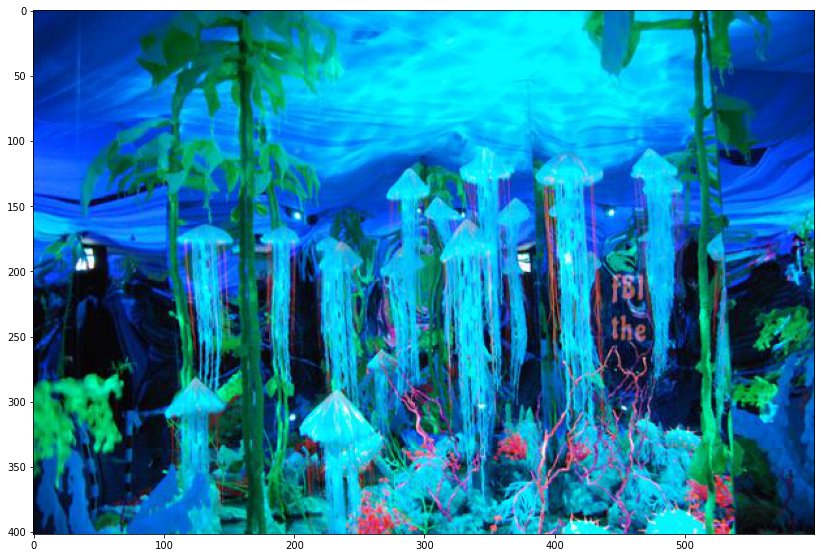

In [11]:
#loading images
plt.figure(figsize=(14,14))
data_path=base_dir+'img_data/SynthText/'
I= io.imread(data_path+im_data['imnames'].values[108])
plt.imshow(I)

print('words in image= ', im_data['txt'].values[108])

### Loading an image and drawing bounding box on text in it.

[[[444, 201], [468, 201], [468, 225], [444, 225]], [[443, 232], [471, 233], [470, 255], [442, 254]]]


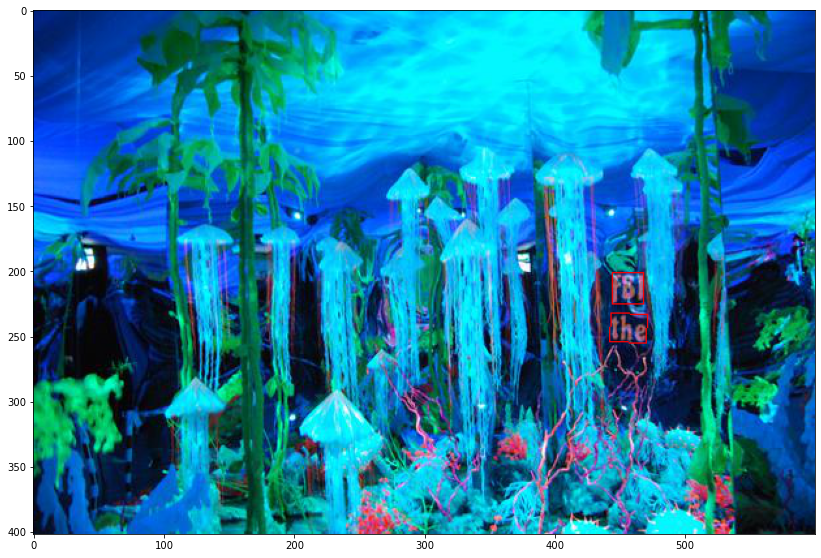

In [23]:
#loading an image from dataset
plt.figure(figsize=(14,14))
data_path=base_dir+'img_data/SynthText/'
I= io.imread(data_path+im_data['imnames'].values[108])

bboxes=ast.literal_eval(im_data['bbox'].values[108])
print(bboxes)
cv2.polylines(I, np.array(bboxes), True, color=(255, 0, 0), thickness=1)
plt.imshow(I)

#### As we can see in above image we are able to draw bounding box correctly on the above image.

In [12]:
#splitting into train test split
from sklearn.model_selection import train_test_split

data_train,data_test= train_test_split(im_data, test_size=0.2, random_state=42)

In [13]:
print(data_train.shape)
print(data_test.shape)
print(type(data_train))
print(type(data_test))

from tensorflow import keras

batch_size=24

(4688, 3)
(1172, 3)
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>


In [14]:
data_train['bbox']

3254    [[[285, 269], [441, 284], [436, 340], [280, 32...
3149    [[[157, 93], [209, 96], [207, 119], [156, 117]...
5465    [[[244, 168], [304, 231], [262, 270], [203, 20...
5605    [[[303, 167], [374, 191], [369, 206], [298, 18...
4943    [[[68, 38], [132, 39], [132, 59], [68, 58]], [...
                              ...                        
3772    [[[159, 87], [300, 91], [298, 147], [158, 143]...
5191    [[[130, 136], [180, 139], [178, 160], [129, 15...
5226    [[[156, 349], [238, 383], [228, 408], [146, 37...
5390    [[[322, 438], [551, 489], [521, 621], [293, 57...
860        [[[51, 184], [82, 187], [81, 201], [50, 198]]]
Name: bbox, Length: 4688, dtype: object

#### We will be using opencv for image processing here because using tensorflow functions is not feasible. As we are doing lot of tensor updates, and tf tensors are immutable, therefore not allowing tensor's updates based on indices(which is necessary for this)

##### https://github.com/tensorflow/tensorflow/issues/33131
##### Not implemented: tensors cannot be updated inplace.
##### tensor[indices] = updates X

In [15]:
#This fn loads all the annotations of an image and stores them in the list with same index as images 
import ast
def load_annotations(row):
    polygons=[]
    boxes=[]
    boxes_cv=[]
    labels=[]
    text_tags=[]
    #print(row)
    bboxes= row[2]
#     words= row.words.str.split(',').tolist()[0]
#     bbox= tf.strings.split(bbox,':').numpy()
   
    # covert b'string to string -> https://stackoverflow.com/a/606199/6868740    
    #bbox= row[3].decode("utf-8").split(':') 
    
    bboxes=bboxes.decode("utf-8")
 #[[[285, 269], [441, 284], [436, 340], [280, 325]], [[145, 61], [247, 61], [247, 95], [145, 94]], [[275, 61], [305, 61], [305, 95], [275, 95]], [[246, 162], [316, 180], [309, 208], [239, 190]], [[6, 28], [51, 39], [47, 53], [2, 41]], [[4, 53], [43, 62], [39, 76], [1, 68]], [[550, 85], [589, 85], [589, 105], [550, 105]], [[131, 10], [240, 10], [240, 61], [131, 61]], [[259, 221], [342, 236], [337, 262], [254, 247]], [[50, 26], [96, 39], [91, 54], [46, 42]], [[51, 56], [87, 64], [83, 81], [47, 73]], [[102, 73], [120, 77], [117, 89], [99, 85]], [[53, 93], [101, 102], [99, 116], [50, 107]], [[54, 123], [103, 130], [100, 151], [50, 143]], [[522, 11], [558, 10], [559, 22], [522, 23]], [[522, 34], [557, 33], [558, 51], [522, 52]], [[521, 64], [564, 63], [564, 81], [522, 82]]]     
    #convert string repressentation of nested lists - https://stackoverflow.com/a/36704560
    bboxes=ast.literal_eval(bboxes)


        
    return bboxes
    
    


In [16]:
def resize_img_my(img, new_size):
    newh=neww=new_size
    
#     neww = 1100
#     newh = int(neww*(h/w))
    h,w=img.shape[0:2]
    #calculating aspect ratio of height and width wrt to old size - done by self
    w_scale = neww/w
    h_scale = newh/h

#     print('new width = ',neww)
#     print('new height = ',newh)
#     print('new width = ',w)
#     print('new height = ',h)
#     print('scale ratio of new width = ',w_scale)
#     print('scale ratio of new height = ',h_scale)

    img= cv2.resize(img,(neww,newh))
    
#          (int(box[0]*w_scale), int(box[1]*h_scale)), (int((box[0] + box[2])*w_scale), int((box[1] + box[3])*h_scale)), (0, 102, 255), 2)
#         cv2.putText(I, words[i], (int(box[0]*w_scale),int(box[1]*h_scale)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 250, 10), 2)
    return img,h_scale,w_scale

In [17]:


def crop_area(im, polys, crop_background=False, max_tries=50):
    '''
    make random crop from the input image
    :param im:
    :param polys:
    :param tags:
    :param crop_background:
    :param max_tries:
    :return:
    '''
    h, w, _ = im.shape
    pad_h = h//10
    pad_w = w//10
    h_array = np.zeros((h + pad_h*2), dtype=np.int32)
    w_array = np.zeros((w + pad_w*2), dtype=np.int32)
    for poly in polys:
        poly = np.round(poly, decimals=0).astype(np.int32)
        minx = np.min(poly[:, 0])
        maxx = np.max(poly[:, 0])
        w_array[minx+pad_w:maxx+pad_w] = 1
        miny = np.min(poly[:, 1])
        maxy = np.max(poly[:, 1])
        h_array[miny+pad_h:maxy+pad_h] = 1
    # ensure the cropped area not across a text
    h_axis = np.where(h_array == 0)[0]
    w_axis = np.where(w_array == 0)[0]
    if len(h_axis) == 0 or len(w_axis) == 0:
        return im, polys, tags
    for i in range(max_tries):
        xx = np.random.choice(w_axis, size=2)
        xmin = np.min(xx) - pad_w
        xmax = np.max(xx) - pad_w
        xmin = np.clip(xmin, 0, w-1)
        xmax = np.clip(xmax, 0, w-1)
        yy = np.random.choice(h_axis, size=2)
        ymin = np.min(yy) - pad_h
        ymax = np.max(yy) - pad_h
        ymin = np.clip(ymin, 0, h-1)
        ymax = np.clip(ymax, 0, h-1)
        if xmax - xmin < 0.1*w or ymax - ymin < 0.1*h:
            # area too small
            continue
        if polys.shape[0] != 0:
            poly_axis_in_area = (polys[:, :, 0] >= xmin) & (polys[:, :, 0] <= xmax) \
                                & (polys[:, :, 1] >= ymin) & (polys[:, :, 1] <= ymax)
            selected_polys = np.where(np.sum(poly_axis_in_area, axis=1) == 4)[0]
        else:
            selected_polys = []
        if len(selected_polys) == 0:
            # no text in this area
            if crop_background:
                return im[ymin:ymax+1, xmin:xmax+1, :], polys[selected_polys]
            else:
                continue
        im = im[ymin:ymax+1, xmin:xmax+1, :]
        polys = polys[selected_polys]
        polys[:, :, 0] -= xmin
        polys[:, :, 1] -= ymin
        return im, polys

    return im, polys

In [18]:
def get_target_label(img_size,im_size, bboxes):
    
    labels=generate_rbox(im_size,bboxes)
    return labels[0],labels[1]

In [19]:

def generate_rbox(im_size, polys):
    h, w = im_size
    shrinked_poly_mask = np.zeros((h, w), dtype=np.uint8)
    orig_poly_mask = np.zeros((h, w), dtype=np.uint8)
    score_map = np.zeros((h, w), dtype=np.uint8)
    geo_map = np.zeros((h, w, 5), dtype=np.float32)
    # mask used during traning, to ignore some hard areas
    overly_small_text_region_training_mask = np.ones((h, w), dtype=np.uint8)
    for poly_idx, poly_data in enumerate(zip(polys, polys)):
        poly = poly_data[0]
        #tag = poly_data[1]

        r = [None, None, None, None]
        for i in range(4):
            r[i] = min(np.linalg.norm(poly[i] - poly[(i + 1) % 4]),
                       np.linalg.norm(poly[i] - poly[(i - 1) % 4]))
        # score map
        shrinked_poly = shrink_poly(poly.copy(), r).astype(np.int32)[np.newaxis, :, :]
        cv2.fillPoly(score_map, shrinked_poly, 1)
        cv2.fillPoly(shrinked_poly_mask, shrinked_poly, poly_idx + 1)
        cv2.fillPoly(orig_poly_mask, poly.astype(np.int32)[np.newaxis, :, :], 1)
        # if the poly is too small, then ignore it during training
        poly_h = min(np.linalg.norm(poly[0] - poly[3]), np.linalg.norm(poly[1] - poly[2]))
        poly_w = min(np.linalg.norm(poly[0] - poly[1]), np.linalg.norm(poly[2] - poly[3]))
        if min(poly_h, poly_w) < 10:
            cv2.fillPoly(overly_small_text_region_training_mask, poly.astype(np.int32)[np.newaxis, :, :], 0)
        # if tag:
        #     cv2.fillPoly(overly_small_text_region_training_mask, poly.astype(np.int32)[np.newaxis, :, :], 0)

        xy_in_poly = np.argwhere(shrinked_poly_mask == (poly_idx + 1))
        # if geometry == 'RBOX':
        # generate a parallelogram for any combination of two vertices
        fitted_parallelograms = []
        for i in range(4):
            p0 = poly[i]
            p1 = poly[(i + 1) % 4]
            p2 = poly[(i + 2) % 4]
            p3 = poly[(i + 3) % 4]
            edge = fit_line([p0[0], p1[0]], [p0[1], p1[1]])
            backward_edge = fit_line([p0[0], p3[0]], [p0[1], p3[1]])
            forward_edge = fit_line([p1[0], p2[0]], [p1[1], p2[1]])
            if point_dist_to_line(p0, p1, p2) > point_dist_to_line(p0, p1, p3):
                # parallel lines through p2
                if edge[1] == 0:
                    edge_opposite = [1, 0, -p2[0]]
                else:
                    edge_opposite = [edge[0], -1, p2[1] - edge[0] * p2[0]]
            else:
                # after p3
                if edge[1] == 0:
                    edge_opposite = [1, 0, -p3[0]]
                else:
                    edge_opposite = [edge[0], -1, p3[1] - edge[0] * p3[0]]
            # move forward edge
            new_p0 = p0
            new_p1 = p1
            new_p2 = p2
            new_p3 = p3
            new_p2 = line_cross_point(forward_edge, edge_opposite)
            if point_dist_to_line(p1, new_p2, p0) > point_dist_to_line(p1, new_p2, p3):
                # across p0
                if forward_edge[1] == 0:
                    forward_opposite = [1, 0, -p0[0]]
                else:
                    forward_opposite = [forward_edge[0], -1, p0[1] - forward_edge[0] * p0[0]]
            else:
                # across p3
                if forward_edge[1] == 0:
                    forward_opposite = [1, 0, -p3[0]]
                else:
                    forward_opposite = [forward_edge[0], -1, p3[1] - forward_edge[0] * p3[0]]
            new_p0 = line_cross_point(forward_opposite, edge)
            new_p3 = line_cross_point(forward_opposite, edge_opposite)
            fitted_parallelograms.append([new_p0, new_p1, new_p2, new_p3, new_p0])
            # or move backward edge
            new_p0 = p0
            new_p1 = p1
            new_p2 = p2
            new_p3 = p3
            new_p3 = line_cross_point( backward_edge, edge_opposite)
            if point_dist_to_line(p0, p3, p1) > point_dist_to_line(p0, p3, p2):
                # across p1
                if backward_edge[1] == 0:
                    backward_opposite = [1, 0, -p1[0]]
                else:
                    backward_opposite = [backward_edge[0], -1, p1[1] - backward_edge[0] * p1[0]]
            else:
                # across p2
                if backward_edge[1] == 0:
                    backward_opposite = [1, 0, -p2[0]]
                else:
                    backward_opposite = [backward_edge[0], -1, p2[1] - backward_edge[0] * p2[0]]
            new_p1 = line_cross_point( backward_opposite, edge)
            new_p2 = line_cross_point( backward_opposite, edge_opposite)
            fitted_parallelograms.append([new_p0, new_p1, new_p2, new_p3, new_p0])
        
        areas = [Polygon(t).area for t in fitted_parallelograms]
        parallelogram = np.array(fitted_parallelograms[np.argmin(areas)][:-1], dtype=np.float32)
        # sort thie polygon
        parallelogram_coord_sum = np.sum(parallelogram, axis=1)
        min_coord_idx = np.argmin(parallelogram_coord_sum)
        parallelogram = parallelogram[
            [min_coord_idx, (min_coord_idx + 1) % 4, (min_coord_idx + 2) % 4, (min_coord_idx + 3) % 4]]

        rectange = rectangle_from_parallelogram(parallelogram)
        rectange, rotate_angle = sort_rectangle(rectange)
        p0_rect, p1_rect, p2_rect, p3_rect = rectange
        for y, x in xy_in_poly:
            point = np.array([x, y], dtype=np.float32)
            # top
            geo_map[y, x, 0] = point_dist_to_line(p0_rect, p1_rect, point)
            # right
            geo_map[y, x, 1] = point_dist_to_line(p1_rect, p2_rect, point)
            # down
            geo_map[y, x, 2] = point_dist_to_line(p2_rect, p3_rect, point)
            # left
            geo_map[y, x, 3] = point_dist_to_line(p3_rect, p0_rect, point)
            # angle
            geo_map[y, x, 4] = rotate_angle
    
    shrinked_poly_mask = (shrinked_poly_mask > 0).astype('uint8')
    text_region_boundary_training_mask = 1 - (orig_poly_mask - shrinked_poly_mask)

    return score_map, geo_map



def pad_image(img, input_size, is_train):
    new_h, new_w, _ = img.shape
    max_h_w_i = np.max([new_h, new_w, input_size])
    img_padded = np.zeros((max_h_w_i, max_h_w_i, 3), dtype=np.uint8)
    if is_train:
        shift_h = np.random.randint(max_h_w_i - new_h + 1)
        shift_w = np.random.randint(max_h_w_i - new_w + 1)
    else:
        shift_h = (max_h_w_i - new_h) // 2
        shift_w = (max_h_w_i - new_w) // 2
    img_padded[shift_h:new_h+shift_h, shift_w:new_w+shift_w, :] = np.array(img).copy()
    img = img_padded
    return img, shift_h, shift_w

def resize_image(img, text_polys, input_size, shift_h, shift_w):
    new_h, new_w, _ = img.shape
    img = cv2.resize(img, dsize=(input_size, input_size))
    # pad and resize text polygons
    resize_ratio_3_x = input_size/float(new_w)
    resize_ratio_3_y = input_size/float(new_h)
    text_polys[:, :, 0] += shift_w
    text_polys[:, :, 1] += shift_h
    text_polys[:, :, 0] *= resize_ratio_3_x
    text_polys[:, :, 1] *= resize_ratio_3_y
    return img, text_polys

In [20]:
def shrink_poly(poly, r):
    '''
    fit a poly inside the origin poly, maybe bugs here...
    used for generating the score map
    :param poly: the text poly
    :param r: r in the paper
    :return: the shrinked poly
    '''
    # shrink ratio
    R = 0.3
    # find the longer pair
    if np.linalg.norm(poly[0] - poly[1]) + np.linalg.norm(poly[2] - poly[3]) > \
                    np.linalg.norm(poly[0] - poly[3]) + np.linalg.norm(poly[1] - poly[2]):
        # first move (p0, p1), (p2, p3), then (p0, p3), (p1, p2)
        ## p0, p1
        theta = np.arctan2((poly[1][1] - poly[0][1]), (poly[1][0] - poly[0][0]))
        poly[0][0] += R * r[0] * np.cos(theta)
        poly[0][1] += R * r[0] * np.sin(theta)
        poly[1][0] -= R * r[1] * np.cos(theta)
        poly[1][1] -= R * r[1] * np.sin(theta)
        ## p2, p3
        theta = np.arctan2((poly[2][1] - poly[3][1]), (poly[2][0] - poly[3][0]))
        poly[3][0] += R * r[3] * np.cos(theta)
        poly[3][1] += R * r[3] * np.sin(theta)
        poly[2][0] -= R * r[2] * np.cos(theta)
        poly[2][1] -= R * r[2] * np.sin(theta)
        ## p0, p3
        theta = np.arctan2((poly[3][0] - poly[0][0]), (poly[3][1] - poly[0][1]))
        poly[0][0] += R * r[0] * np.sin(theta)
        poly[0][1] += R * r[0] * np.cos(theta)
        poly[3][0] -= R * r[3] * np.sin(theta)
        poly[3][1] -= R * r[3] * np.cos(theta)
        ## p1, p2
        theta = np.arctan2((poly[2][0] - poly[1][0]), (poly[2][1] - poly[1][1]))
        poly[1][0] += R * r[1] * np.sin(theta)
        poly[1][1] += R * r[1] * np.cos(theta)
        poly[2][0] -= R * r[2] * np.sin(theta)
        poly[2][1] -= R * r[2] * np.cos(theta)
    else:
        ## p0, p3
        # print poly
        theta = np.arctan2((poly[3][0] - poly[0][0]), (poly[3][1] - poly[0][1]))
        poly[0][0] += R * r[0] * np.sin(theta)
        poly[0][1] += R * r[0] * np.cos(theta)
        poly[3][0] -= R * r[3] * np.sin(theta)
        poly[3][1] -= R * r[3] * np.cos(theta)
        ## p1, p2
        theta = np.arctan2((poly[2][0] - poly[1][0]), (poly[2][1] - poly[1][1]))
        poly[1][0] += R * r[1] * np.sin(theta)
        poly[1][1] += R * r[1] * np.cos(theta)
        poly[2][0] -= R * r[2] * np.sin(theta)
        poly[2][1] -= R * r[2] * np.cos(theta)
        ## p0, p1
        theta = np.arctan2((poly[1][1] - poly[0][1]), (poly[1][0] - poly[0][0]))
        poly[0][0] += R * r[0] * np.cos(theta)
        poly[0][1] += R * r[0] * np.sin(theta)
        poly[1][0] -= R * r[1] * np.cos(theta)
        poly[1][1] -= R * r[1] * np.sin(theta)
        ## p2, p3
        theta = np.arctan2((poly[2][1] - poly[3][1]), (poly[2][0] - poly[3][0]))
        poly[3][0] += R * r[3] * np.cos(theta)
        poly[3][1] += R * r[3] * np.sin(theta)
        poly[2][0] -= R * r[2] * np.cos(theta)
        poly[2][1] -= R * r[2] * np.sin(theta)
    return poly

def fit_line(p1, p2):
    # fit a line ax+by+c = 0
    if p1[0] == p1[1]:
        return [1., 0., -p1[0]]
    else:
        [k, b] = np.polyfit(p1, p2, deg=1)
        return [k, -1., b]


def line_cross_point(line1, line2):
    # line1 0= ax+by+c, compute the cross point of line1 and line2
    if line1[0] != 0 and line1[0] == line2[0]:
        if not True:
            print('Cross point does not exist')
        return None
    if line1[0] == 0 and line2[0] == 0:
        if not True:
            print('Cross point does not exist')
        return None
    if line1[1] == 0:
        x = -line1[2]
        y = line2[0] * x + line2[2]
    elif line2[1] == 0:
        x = -line2[2]
        y = line1[0] * x + line1[2]
    else:
        k1, _, b1 = line1
        k2, _, b2 = line2
        x = -(b1-b2)/(k1-k2)
        y = k1*x + b1
    return np.array([x, y], dtype=np.float32)


def line_verticle(line, point):
    # get the verticle line from line across point
    if line[1] == 0:
        verticle = [0, -1, point[1]]
    else:
        if line[0] == 0:
            verticle = [1, 0, -point[0]]
        else:
            verticle = [-1./line[0], -1, point[1] - (-1/line[0] * point[0])]
    return verticle


def rectangle_from_parallelogram( poly):
    '''
    fit a rectangle from a parallelogram
    :param poly:
    :return:
    '''
    p0, p1, p2, p3 = poly
    angle_p0 = np.arccos(np.dot(p1-p0, p3-p0)/(np.linalg.norm(p0-p1) * np.linalg.norm(p3-p0)))
    if angle_p0 < 0.5 * np.pi:
        if np.linalg.norm(p0 - p1) > np.linalg.norm(p0-p3):
            # p0 and p2
            ## p0
            p2p3 = fit_line([p2[0], p3[0]], [p2[1], p3[1]])
            p2p3_verticle = line_verticle(p2p3, p0)

            new_p3 = line_cross_point( p2p3, p2p3_verticle)
            ## p2
            p0p1 = fit_line([p0[0], p1[0]], [p0[1], p1[1]])
            p0p1_verticle = line_verticle(p0p1, p2)

            new_p1 = line_cross_point( p0p1, p0p1_verticle)
            return np.array([p0, new_p1, p2, new_p3], dtype=np.float32)
        else:
            p1p2 = fit_line([p1[0], p2[0]], [p1[1], p2[1]])
            p1p2_verticle = line_verticle(p1p2, p0)

            new_p1 = line_cross_point( p1p2, p1p2_verticle)
            p0p3 = fit_line([p0[0], p3[0]], [p0[1], p3[1]])
            p0p3_verticle = line_verticle(p0p3, p2)

            new_p3 = line_cross_point( p0p3, p0p3_verticle)
            return np.array([p0, new_p1, p2, new_p3], dtype=np.float32)
    else:
        if np.linalg.norm(p0-p1) > np.linalg.norm(p0-p3):
            # p1 and p3
            ## p1
            p2p3 = fit_line([p2[0], p3[0]], [p2[1], p3[1]])
            p2p3_verticle = line_verticle(p2p3, p1)

            new_p2 = line_cross_point( p2p3, p2p3_verticle)
            ## p3
            p0p1 = fit_line([p0[0], p1[0]], [p0[1], p1[1]])
            p0p1_verticle = line_verticle(p0p1, p3)

            new_p0 = line_cross_point( p0p1, p0p1_verticle)
            return np.array([new_p0, p1, new_p2, p3], dtype=np.float32)
        else:
            p0p3 = fit_line([p0[0], p3[0]], [p0[1], p3[1]])
            p0p3_verticle = line_verticle(p0p3, p1)

            new_p0 = line_cross_point( p0p3, p0p3_verticle)
            p1p2 = fit_line([p1[0], p2[0]], [p1[1], p2[1]])
            p1p2_verticle = line_verticle(p1p2, p3)

            new_p2 = line_cross_point( p1p2, p1p2_verticle)
            return np.array([new_p0, p1, new_p2, p3], dtype=np.float32)


def sort_rectangle(poly):
    # sort the four coordinates of the polygon, points in poly should be sorted clockwise
    # First find the lowest po
    p_lowest = np.argmax(poly[:, 1])
    if np.count_nonzero(poly[:, 1] == poly[p_lowest, 1]) == 2:
        # if the bottom line is parallel to x-axis, then p0 must be the upper-left corner
        p0_index = np.argmin(np.sum(poly, axis=1))
        p1_index = (p0_index + 1) % 4
        p2_index = (p0_index + 2) % 4
        p3_index = (p0_index + 3) % 4
        return poly[[p0_index, p1_index, p2_index, p3_index]], 0.
    else:
        # find the point that sits right to the lowest point
        p_lowest_right = (p_lowest - 1) % 4
        p_lowest_left = (p_lowest + 1) % 4
        angle = np.arctan(-(poly[p_lowest][1] - poly[p_lowest_right][1])/(poly[p_lowest][0] - poly[p_lowest_right][0]))
        # assert angle > 0
        if angle <= 0:
            if not True:
                print(angle, poly[p_lowest], poly[p_lowest_right])
        if angle/np.pi * 180 > 45:
            # 这个点为p2 - this point is p2
            p2_index = p_lowest
            p1_index = (p2_index - 1) % 4
            p0_index = (p2_index - 2) % 4
            p3_index = (p2_index + 1) % 4
            return poly[[p0_index, p1_index, p2_index, p3_index]], -(np.pi/2 - angle)
        else:
            # 这个点为p3 - this point is p3
            p3_index = p_lowest
            p0_index = (p3_index + 1) % 4
            p1_index = (p3_index + 2) % 4
            p2_index = (p3_index + 3) % 4
            return poly[[p0_index, p1_index, p2_index, p3_index]], angle


def point_dist_to_line(p1, p2, p3):
    # compute the distance from p3 to p1-p2
    a=0
    b=0
    c=0
    try:
        a= np.linalg.norm(np.cross(p2 - p1, p1 - p3))
        b= np.linalg.norm(p2 - p1)
        c=a/b
    except:
        print(a)
        print(b)
    return c




In [21]:
# let's make input and output/target variable for text detection problem.
# Input -> images
#target/output -> 
    # arrays of same shape as input image but maskd wherevr txt present in original img.ie.score map for each pixel.
    # arrays of same shape as input image giving 4 outputs xmin,ymin,xmax,ymax
    # associated with each pixel in input image contained in a bounding box.   

In [22]:
def generator(im_data):
    index = np.arange(0, len(im_data))
    data_dir=base_dir+'img_data/SynthText/'
    while(True):
        for i in index:
            boxes=[]
            row= im_data[i]
            img_name=row[0]
            _ =load_annotations(row)

            for box in _ :
                poly=[]
                for cord in box:

                    try:
                        xy= [int(i) for i in cord]

                    except:
                        tf.print(cord)
                        tf.print(img_name)
                        raise Exception('There has been an error in boxgen')
                    poly.append(xy)
                boxes.append(poly)

            if np.array(boxes).shape[0] == 0:
                continue
            im=cv2.imread(data_dir+(img_name).decode("utf-8"))
            #print('h and w are {} {}'. format(h,w)) 

            im, text_polys = crop_area(im , np.array(boxes), crop_background=False)

            h, w, _ = im.shape
            im, shift_h, shift_w = pad_image(im, 512, True)
            im, text_polys = resize_image(im, text_polys.astype(np.float32), 512, shift_h, shift_w)
            new_h, new_w, _ = im.shape


            if text_polys.shape[0] == 0:
                continue
            try:
                score_map,geo_map= get_target_label(512,(new_h, new_w),text_polys)
            except:
                print('error')
                continue


            #because output of EAST produces output 4 times less in dimens from original i.e 512 --> 128, so to match that o/p dimens
            # score_map=score_map[::4, ::4, :].astype(np.float32) 
            # geo_map=geo_map[::4, ::4, :].astype(np.float32)

            im = (im / 127.5) - 1.
            im= im[:, :, ::-1].astype(np.float32)

            score_map= score_map[::4, ::4, np.newaxis].astype(np.float32)
            geo_map= geo_map[::4, ::4, :].astype(np.float32)
            # overly_small_text_region_training_mask = overly_small_text_region_training_mask[::4, ::4, np.newaxis].astype(np.float32)
            # text_region_boundary_training_mask= text_region_boundary_training_mask[::4, ::4, np.newaxis].astype(np.float32)




            #             print(I.shape)
            #             print(score_map.shape)
            #             print(geo_map.shape)
            #             images.append(I)
            #             score_maps.append(score_map)
            #             geo_maps.append(geo_map)

            yield im, (score_map, geo_map)


In [24]:
#https://towardsdatascience.com/building-efficient-data-pipelines-using-tensorflow-8f647f03b4ce
#

In [25]:
dataset_train = tf.data.Dataset.from_generator(generator,
            output_types=(tf.float32, (tf.float32, tf.float32)),
            args = ([data_train]))

In [26]:
dataset_val = tf.data.Dataset.from_generator(generator,
            output_types=(tf.float32, (tf.float32, tf.float32)),
            args = ([data_test]))
dataset_val = dataset_train.batch(batch_size=batch_size)
dataset_val = dataset_val.prefetch(tf.data.experimental.AUTOTUNE)


In [27]:
import time
start_time = time.time()

dataset_train = dataset_train.batch(batch_size=batch_size)
dataset_train = dataset_train.prefetch(tf.data.experimental.AUTOTUNE)

#iterator = batched_dataset.make_one_shot_iterator()
#next_element = iterator.get_next()
lst=[]
cnt=0
for batch, next_element in enumerate(dataset_train):
    cnt+=1

print("--- %s seconds ---" % (time.time() - start_time))

#print(batch)


KeyboardInterrupt: ignored

In [28]:
cnt

3

In [29]:
print(next_element[1][0][0].shape)
print(next_element[1][1][0].shape)
print(next_element[0][0].shape)
print(next_element[0][5].shape)

(128, 128, 1)
(128, 128, 5)
(512, 512, 3)
(512, 512, 3)


In [30]:
print(type(next_element))
tf.shape(next_element[1][1])

<class 'tuple'>


<tf.Tensor: shape=(4,), dtype=int32, numpy=array([ 24, 128, 128,   5], dtype=int32)>

In [31]:
print(next_element[0][0].shape)

(512, 512, 3)


In [32]:
tf.math.count_nonzero(next_element[1][0][0])

<tf.Tensor: shape=(), dtype=int64, numpy=92>

In [269]:

def resize_image_1(im, max_side_len=2400):
    '''
    resize image to a size multiple of 32 which is required by the network
    :param im: the resized image
    :param max_side_len: limit of max image size to avoid out of memory in gpu
    :return: the resized image and the resize ratio
    '''
    h, w, _ = im.shape
    #print(h,w)
    resize_w = w
    resize_h = h

    # limit the max side
    if max(resize_h, resize_w) > max_side_len:
        ratio = float(max_side_len) / resize_h if resize_h > resize_w else float(max_side_len) / resize_w
    else:
        ratio = 1.
    resize_h = int(resize_h * ratio)
    resize_w = int(resize_w * ratio)

    resize_h = resize_h if resize_h % 32 == 0 else (resize_h // 32) * 32
    resize_w = resize_w if resize_w % 32 == 0 else (resize_w // 32) * 32
    im = cv2.resize(im, (int(resize_w), int(resize_h)))

    ratio_h = resize_h / float(h)
    ratio_w = resize_w / float(w)

    return im, (ratio_h, ratio_w)

In [268]:
def detect(score_map, geo_map, score_map_thresh=0.8, box_thresh=0.1, nms_thres=0.2):
    '''
    restore text boxes from score map and geo map
    :param score_map:
    :param geo_map:
    :param score_map_thresh: threshhold for score map
    :param box_thresh: threshhold for boxes
    :param nms_thres: threshold for nms
    :return:
    '''
    
    if len(score_map.shape) == 4:
        score_map = score_map[0, :, :, 0]
        geo_map = geo_map[0, :, :, ]
    # filter the score map
    xy_text = np.argwhere(score_map > score_map_thresh)
    # sort the text boxes via the y axis
    xy_text = xy_text[np.argsort(xy_text[:, 0])]
    # restore
    #start = time.time()
    text_box_restored = restore_rectangle_rbox(xy_text[:, ::-1]*4, geo_map[xy_text[:, 0], xy_text[:, 1], :]) # N*4*2
    boxes = np.zeros((text_box_restored.shape[0], 9), dtype=np.float32)
    boxes[:, :8] = text_box_restored.reshape((-1, 8))
    boxes[:, 8] = score_map[xy_text[:, 0], xy_text[:, 1]]
    #timer['restore'] = time.time() - start
    # nms part
    #start = time.time()
    # boxes = nms_locality.nms_locality(boxes.astype(np.float64), nms_thres)
    boxes = nms_locality(boxes.astype('float32'), nms_thres)
    #timer['nms'] = time.time() - start

    if boxes.shape[0] == 0:
        return None

    # here we filter some low score boxes by the average score map, this is different from the orginal paper
    for i, box in enumerate(boxes):
        mask = np.zeros_like(score_map, dtype=np.uint8)
        cv2.fillPoly(mask, box[:8].reshape((-1, 4, 2)).astype(np.int32) // 4, 1)
        boxes[i, 8] = cv2.mean(score_map, mask)[0]
    boxes = boxes[boxes[:, 8] > box_thresh]

    return boxes


def sort_poly(p):
    min_axis = np.argmin(np.sum(p, axis=1))
    p = p[[min_axis, (min_axis+1)%4, (min_axis+2)%4, (min_axis+3)%4]]
    if abs(p[0, 0] - p[1, 0]) > abs(p[0, 1] - p[1, 1]):
        return p
    else:
        return p[[0, 3, 2, 1]]
        

In [35]:
def restore_rectangle_rbox(origin, geometry):
    d = geometry[:, :4]
    angle = geometry[:, 4]
    # for angle > 0
    origin_0 = origin[angle >= 0]
    d_0 = d[angle >= 0]
    angle_0 = angle[angle >= 0]
    if origin_0.shape[0] > 0:
        p = np.array([np.zeros(d_0.shape[0]), -d_0[:, 0] - d_0[:, 2],
                      d_0[:, 1] + d_0[:, 3], -d_0[:, 0] - d_0[:, 2],
                      d_0[:, 1] + d_0[:, 3], np.zeros(d_0.shape[0]),
                      np.zeros(d_0.shape[0]), np.zeros(d_0.shape[0]),
                      d_0[:, 3], -d_0[:, 2]])
        p = p.transpose((1, 0)).reshape((-1, 5, 2))  # N*5*2

        rotate_matrix_x = np.array([np.cos(angle_0), np.sin(angle_0)]).transpose((1, 0))
        rotate_matrix_x = np.repeat(rotate_matrix_x, 5, axis=1).reshape(-1, 2, 5).transpose((0, 2, 1))  # N*5*2

        rotate_matrix_y = np.array([-np.sin(angle_0), np.cos(angle_0)]).transpose((1, 0))
        rotate_matrix_y = np.repeat(rotate_matrix_y, 5, axis=1).reshape(-1, 2, 5).transpose((0, 2, 1))

        p_rotate_x = np.sum(rotate_matrix_x * p, axis=2)[:, :, np.newaxis]  # N*5*1
        p_rotate_y = np.sum(rotate_matrix_y * p, axis=2)[:, :, np.newaxis]  # N*5*1

        p_rotate = np.concatenate([p_rotate_x, p_rotate_y], axis=2)  # N*5*2
        p3_in_origin = origin_0 - p_rotate[:, 4, :]
        new_p0 = p_rotate[:, 0, :] + p3_in_origin  # N*2
        new_p1 = p_rotate[:, 1, :] + p3_in_origin
        new_p2 = p_rotate[:, 2, :] + p3_in_origin
        new_p3 = p_rotate[:, 3, :] + p3_in_origin

        new_p_0 = np.concatenate([new_p0[:, np.newaxis, :], new_p1[:, np.newaxis, :],
                                  new_p2[:, np.newaxis, :], new_p3[:, np.newaxis, :]], axis=1)  # N*4*2
    else:
        new_p_0 = np.zeros((0, 4, 2))
    # for angle < 0
    origin_1 = origin[angle < 0]
    d_1 = d[angle < 0]
    angle_1 = angle[angle < 0]
    if origin_1.shape[0] > 0:
        p = np.array([-d_1[:, 1] - d_1[:, 3], -d_1[:, 0] - d_1[:, 2],
                      np.zeros(d_1.shape[0]), -d_1[:, 0] - d_1[:, 2],
                      np.zeros(d_1.shape[0]), np.zeros(d_1.shape[0]),
                      -d_1[:, 1] - d_1[:, 3], np.zeros(d_1.shape[0]),
                      -d_1[:, 1], -d_1[:, 2]])
        p = p.transpose((1, 0)).reshape((-1, 5, 2))  # N*5*2

        rotate_matrix_x = np.array([np.cos(-angle_1), -np.sin(-angle_1)]).transpose((1, 0))
        rotate_matrix_x = np.repeat(rotate_matrix_x, 5, axis=1).reshape(-1, 2, 5).transpose((0, 2, 1))  # N*5*2

        rotate_matrix_y = np.array([np.sin(-angle_1), np.cos(-angle_1)]).transpose((1, 0))
        rotate_matrix_y = np.repeat(rotate_matrix_y, 5, axis=1).reshape(-1, 2, 5).transpose((0, 2, 1))

        p_rotate_x = np.sum(rotate_matrix_x * p, axis=2)[:, :, np.newaxis]  # N*5*1
        p_rotate_y = np.sum(rotate_matrix_y * p, axis=2)[:, :, np.newaxis]  # N*5*1

        p_rotate = np.concatenate([p_rotate_x, p_rotate_y], axis=2)  # N*5*2

        p3_in_origin = origin_1 - p_rotate[:, 4, :]
        new_p0 = p_rotate[:, 0, :] + p3_in_origin  # N*2
        new_p1 = p_rotate[:, 1, :] + p3_in_origin
        new_p2 = p_rotate[:, 2, :] + p3_in_origin
        new_p3 = p_rotate[:, 3, :] + p3_in_origin

        new_p_1 = np.concatenate([new_p0[:, np.newaxis, :], new_p1[:, np.newaxis, :],
                                  new_p2[:, np.newaxis, :], new_p3[:, np.newaxis, :]], axis=1)  # N*4*2
    else:
        new_p_1 = np.zeros((0, 4, 2))
    return np.concatenate([new_p_0, new_p_1])


In [36]:
from shapely.geometry import Polygon 
def nms_locality(polys, threshold=0.3):
    S=[]
    p=None
    
    for g in polys:
        if p is not None and iOu(g,p) > threshold:
            p= weighted_merge(g,p)
        else:
            if p is not None:
                S.append(p)
            p=g
    
    if p is not None:
        S.append(p)
    
    if len(S) == 0:
        return np.array([])
    
    return standard_NMS(np.array(S), threshold)


#defining intersection over union fn 
def iOu(g,p):
    g= Polygon(g[:8].reshape((4,2)))
    p= Polygon(p[:8].reshape((4,2)))
    
    if not g.is_valid  or not p.is_valid:
        return 0
    
    inter= Polygon(g).intersection(Polygon(p)).area
    union= g.area + p.area - inter
    
    if union==0:
        return 0
    else:
        return inter/union


#defining weighted_merge fn
def weighted_merge(g,p):
    g[:8]= (g[:8]*g[8] + p[:8]*p[8])/(g[8]+p[8])
    g[8]= g[8]+p[8]
    return g


def standard_NMS(S,thresh):
    indx= np.argsort(S[:,8])[::-1] # [:,8] because we want to sort by score. And after that change it in descending order using -1
    keep=[]
    while len(indx)>0:
        max_score_idx= indx[0]# 0 bcoz now it is in descending order, max is at 1st pos
        keep.append(max_score_idx)
        ovr= np.array([iOu(S[max_score_idx], S[i]) for i in indx[1:]])
        idx= np.where(ovr <= thresh)[0]
        indx = indx[idx+1]
    return S[keep]
        

In [37]:
start_time = time.time()

print('score map shape:',next_element[1][0][2].shape)#score map shape
print('geo map shape:',next_element[1][1][2].shape)
print('input image shape:',next_element[0][0][2].shape)

img_resized= next_element[0][2]
timer = {'net': 0, 'restore': 0, 'nms': 0}
start = time.time()

# feed image into model
#score_map, geo_map = model.predict(img_resized[np.newaxis, :, :, :])
score_map=np.array(next_element[1][0][2])
geo_map= np.array(next_element[1][1][2])
score_map= score_map[np.newaxis, :,:,:] 
geo_map= geo_map[np.newaxis, :,:,:] 

timer['net'] = time.time() - start

# ii=cv2.imread(base_dir+'img_data/SynthText/143/rajasthan_99_1.jpg')
# ii=ii[:, :, ::-1]
# ii=ii.astype(np.uint8)
# img_resizeda, ratio_h, ratio_w = resize_img_my(ii,512)


boxes = detect(score_map=score_map, geo_map=geo_map)
if boxes is not None:
  boxes = boxes[:, :8].reshape((-1, 4, 2))
  # boxes[:, :, 0] /= ratio_w
  # boxes[:, :, 1] /= ratio_h

print(boxes)


score map shape: (128, 128, 1)
geo map shape: (128, 128, 5)
input image shape: (512, 3)
242 text boxes before nms
[[[139.       112.      ]
  [317.6827   106.952446]
  [318.954    151.97285 ]
  [140.27168  157.02094 ]]

 [[139.00261  176.04749 ]
  [203.28513  172.98636 ]
  [205.       209.      ]
  [140.7176   212.06105 ]]

 [[148.       319.      ]
  [206.       319.      ]
  [206.       341.      ]
  [148.       341.      ]]]


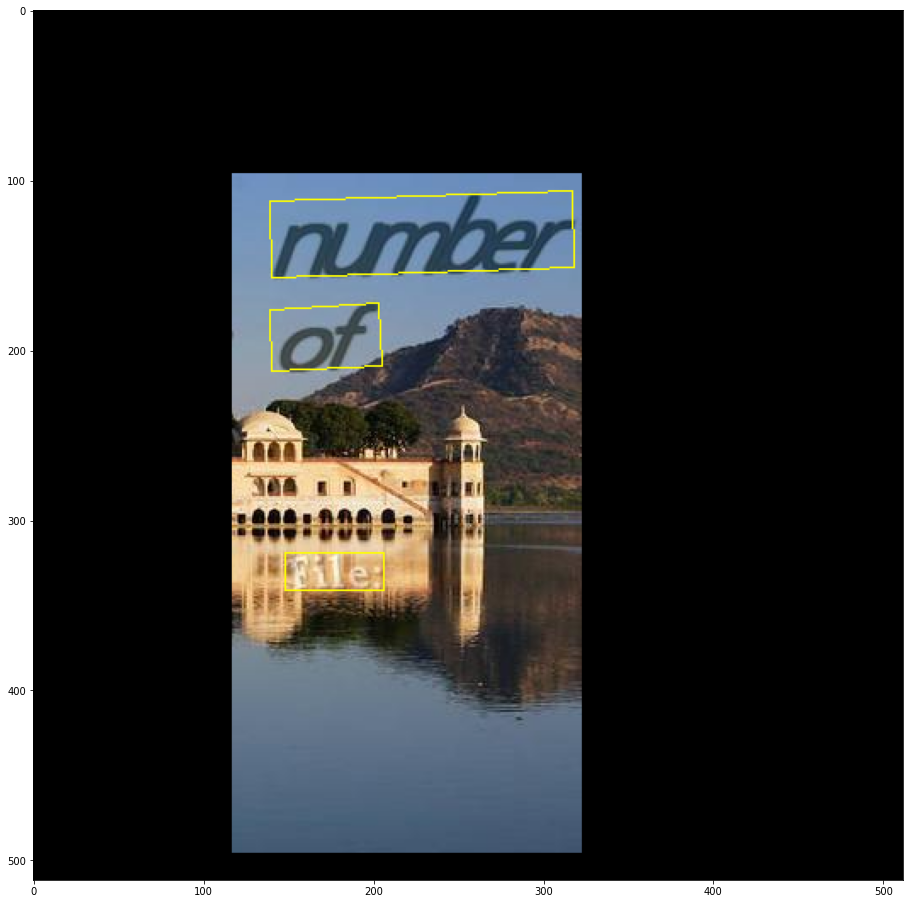

In [38]:
plt.figure(figsize=(16,16))


img_i= (np.array(img_resized)+1) *127.5
img_i= img_i.astype(np.uint8)
# print(type(img_i))

# img_i=img_i[::4, ::4, :].astype(np.uint8)

for box in boxes:
  # to avoid submitting errors
    box = sort_poly(box.astype(np.int32))
    if np.linalg.norm(box[0] - box[1]) < 5 or np.linalg.norm(box[3]-box[0]) < 5:
        continue
  
    img_i=cv2.polylines(img_i, [box.astype(np.int32).reshape((-1, 1, 2))], True, color=(255, 255, 0), thickness=1)

#ii=cv2.imread(base_dir+'img_data/SynthText/'+im_data['imnames'].values[71])
bb= ast.literal_eval(im_data['bbox'].values[71])
bb=np.array(bb)
#ii = cv2.polylines(ii, bb, True, (255,0,0), 1)
#img_i = cv2.polylines(img_i, bb, True, (255,0,0), 1)
plt.imshow(img_i) 
plt.show()





### As we can see in above, we are able to draw bounding boxes on image baed on score map and geometry map, which we will get after inference from the model

#### EAST model implementation

In [39]:
from tensorflow import keras
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, concatenate, BatchNormalization, Activation, MaxPooling2D, Dropout, Lambda
from tensorflow.keras import regularizers
from tensorflow.keras.applications.resnet50 import ResNet50
import tensorflow.keras.backend as K
import os


#ValueError: Unexpectedly found an instance of type `<class 'keras.engine.keras_tensor.KerasTensor'>`. Expected a symbolic tensor instance.
#https://github.com/slundberg/shap/issues/1165#issuecomment-637179395
#change import from keras to tensorflow.keras

In [40]:
def unpoolx2(x, RESIZE_FACTOR=2):
    return tf.image.resize(x, size=[K.shape(x)[1]*RESIZE_FACTOR, K.shape(x)[2]*RESIZE_FACTOR], method=tf.image.ResizeMethod.BILINEAR)

class EAST_model:
    
    def __init__(self,in_shape):

        input_image= Input(shape=(None,None,3), name='input_image')
#         input_score_map= Input(shape=(None,None,1), name='input_score_map')
#         input_geo_map= Input(shape=(None,None,8), name='input_geo_map')


        resnet= ResNet50(input_tensor=input_image, weights='imagenet', include_top=False, pooling=None)

        #model= resnet.get_layer('conv5_block3_out').output
        conv_stage_4= resnet.get_layer('conv5_block3_out').output
        conv_stage_3= resnet.get_layer('conv4_block6_out').output
        conv_stage_2= resnet.get_layer('conv3_block4_out').output
        conv_stage_1= resnet.get_layer('conv2_block3_out').output

        #print(resnet.summary())

        model= Lambda(unpoolx2, name='unpool_1')(conv_stage_4)
        model= concatenate([model, conv_stage_3], axis=3)
        model= Conv2D(128, 1, padding='same', kernel_regularizer=regularizers.l2(1e-5))(model)
        model= BatchNormalization()(model)
        model= Activation('relu')(model)
        model= Conv2D(128, 3, padding='same', kernel_regularizer=regularizers.l2(1e-5))(model)
        model= BatchNormalization(name='BatchNormalization_1')(model)
        model= Activation('relu')(model)

        model= Lambda(unpoolx2, name='unpool_2')(model)
        model= concatenate([model, conv_stage_2], axis=3)
        model= Conv2D(64, 1, padding='same', kernel_regularizer=regularizers.l2(1e-5))(model)
        model= BatchNormalization(name='BatchNormalization_2')(model)
        model= Activation('relu')(model)
        model= Conv2D(64, 3, padding='same', kernel_regularizer=regularizers.l2(1e-5))(model)
        model= BatchNormalization(name='BatchNormalization_3')(model)
        model= Activation('relu')(model)

        model= Lambda(unpoolx2, name='unpool_3')(model)
        model= concatenate([model, conv_stage_1], axis=3)
        model= Conv2D(32, 1, padding='same', kernel_regularizer=regularizers.l2(1e-5))(model)
        model= BatchNormalization(name='BatchNormalization_4')(model)
        model= Activation('relu')(model)
        model= Conv2D(32, 3, padding='same', kernel_regularizer=regularizers.l2(1e-5))(model)
        model= BatchNormalization(name='BatchNormalization_5')(model)
        model= Activation('relu')(model)

        model= Conv2D(32, 3, padding='same', kernel_regularizer=regularizers.l2(1e-5))(model)

        pred_score_map= Conv2D(1, 1, activation= keras.activations.sigmoid, name='pred_score_map')(model)
        rbox_map= Conv2D(4, 1, activation= keras.activations.sigmoid, name='rbox_geo_map')(model)
        #we are multiplying each value in output feature map(128x128) to input size as each val will be between 0 to 1 becuse of sigmoid fn used as activation 
        rbox_map = Lambda(lambda x: x * 512)(rbox_map)
        angle_map= Conv2D(1,1,activation=tf.nn.sigmoid, name='rbox_angle_map')(model)
        angle_map= Lambda(lambda x:(x-0.5)*np.pi/2)(angle_map)
        pred_geo_map= concatenate([rbox_map,angle_map], axis=3, name='pred_geo_map')

        final_model= Model(inputs=[input_image], outputs=[pred_score_map,pred_geo_map]) 

        self.model= final_model
        self.input_image= input_image
        self.pred_score_map= pred_score_map
        self.pred_geo_map= pred_geo_map
        

In [56]:
final_model=EAST_model(512)
final_model.model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_image (InputLayer)        [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, None, None, 3 0           input_image[0][0]                
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, None, None, 6 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, None, None, 6 256         conv1_conv[0][0]                 
____________________________________________________________________________________________

#### Visualize model architecture

In [ ]:
#In notebook as pdf was not being generated because of model architecture diagram

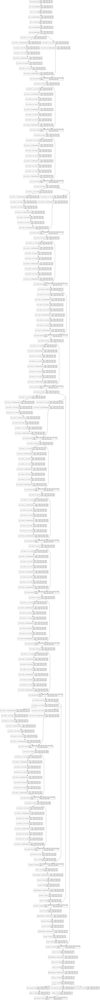

In [286]:
tf.keras.utils.plot_model(final_model.model,show_shapes=True)

In [57]:

#     return 2. * intersection / (K.sum((y_true),-1) + K.sum((y_pred),-1) + smooth)

def dice_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(y_true * y_pred, axis=[1,2,3])
    union = K.sum(y_true, axis=[1,2,3]) + K.sum(y_pred, axis=[1,2,3])
    return K.mean( (2. * intersection + smooth) / (union + smooth), axis=0)

def dice_coef_loss(y_true, y_pred):
    return 1. - dice_coef(y_true, y_pred)
    
def rbox_loss(y_true, y_pred):
    d1_gt, d2_gt, d3_gt, d4_gt, theta_gt = tf.split(value=y_true, num_or_size_splits=5, axis=3)
    d1_pred, d2_pred, d3_pred, d4_pred, theta_pred = tf.split(value=y_pred, num_or_size_splits=5, axis=3)
    area_gt = (d1_gt + d3_gt) * (d2_gt + d4_gt)
    area_pred = (d1_pred + d3_pred) * (d2_pred + d4_pred)
    w_union = tf.minimum(d2_gt, d2_pred) + tf.minimum(d4_gt, d4_pred)
    h_union = tf.minimum(d1_gt, d1_pred) + tf.minimum(d3_gt, d3_pred)
    area_intersect = w_union * h_union
    area_union = area_gt + area_pred - area_intersect
    L_AABB = -tf.math.log((area_intersect + 1.0)/(area_union + 1.0))
    L_theta = 1 - tf.math.cos(theta_pred - theta_gt)
    L_g = L_AABB + 20 * L_theta
    ll= tf.reduce_mean(L_g)
    return ll



    


In [58]:
optim= keras.optimizers.Adam(learning_rate=1e-4, epsilon=1e-08)

final_model.model.compile(loss=[dice_coef_loss,rbox_loss],
                          loss_weights=[1., 1.],  
                          optimizer=optim)

#final_model.model.summary()

In [59]:
#https://stackoverflow.com/a/53579680

%load_ext tensorboard
import datetime
from tensorflow.keras.callbacks import LearningRateScheduler


def my_learning_rate(epoch):
    if epoch > 10:
        lrate=0.00001
        return lrate
    elif epoch > 3:
        lrate=0.0001
        return lrate
    else:
        lrate=0.001
        return lrate

lrs = LearningRateScheduler(my_learning_rate)


# !rm -rf ./content/gdrive/MyDrive/model_vars/logs/log2/
#log4-10 epoch
#log6- 10 to 15 epochs
#log7- 15 to 20 epochs
#log9 - new till 15 epoch
#log10 - till 28 epoch
log_dir = "/content/gdrive/MyDrive/model_vars/logs/log10/20210615-045354"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

checkpoint_filepath = '/content/gdrive/MyDrive/model_vars/checkpoint/new/cp10.ckpt'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True)


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [61]:
final_model.model.load_weights('/content/gdrive/MyDrive/model_vars/checkpoint/new/cp10.ckpt')

In [ ]:
#Was getting memory leak, to avoid that removed cache() from dataset generator.  Only kept prefetch()
      
history = final_model.model.fit(dataset_train, epochs=30, initial_epoch=10, steps_per_epoch=(len(data_train)/batch_size), verbose=1,
                                validation_data=dataset_val, validation_steps=(len(data_test)/batch_size),
                                callbacks=[tensorboard_callback, model_checkpoint_callback, lrs],workers=4)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 11/30
195/195 [==============================] - 5141s 26s/step - loss: 0.3506 - pred_score_map_loss: 0.2817 - pred_geo_map_loss: 0.0624 - val_loss: 0.3440 - val_pred_score_map_loss: 0.2771 - val_pred_geo_map_loss: 0.0604
Epoch 12/30
195/195 [==============================] - 3444s 18s/step - loss: 0.3364 - pred_score_map_loss: 0.2701 - pred_geo_map_loss: 0.0598 - val_loss: 0.3185 - val_pred_score_map_loss: 0.2542 - val_pred_geo_map_loss: 0.0579
Epoch 13/30
195/195 [==============================] - 3619s 19s/step - loss: 0.3302 - pred_score_map_loss: 0.2641 - pred_geo_map_loss: 0.0596 - val_loss: 0.3196 - val_pred_score_map_loss: 0.2553 - val_pred_geo_map_loss: 0.0578
Epoch 14/30
195/195 [==============================] - 3697s 19s/step - loss: 0.3237 - pred_score_map_loss: 0.2590 - pred_geo_map_loss: 0.0582 - val_loss: 0.3133 - val_pred_score_map_loss: 0.2515 - val_pred_geo_map_loss: 0.0553
Epoch 15/30
195/195 [==============================] - 4038s 21s/step - loss: 0.3220 - p

In [45]:
#Was getting memory leak, to avoid that removed cache() from dataset generator.  Only kept prefetch()
      
history = final_model.model.fit(dataset_train, epochs=30, initial_epoch=27, steps_per_epoch=(len(data_train)/batch_size), verbose=1,
                                validation_data=dataset_val, validation_steps=(len(data_test)/batch_size),
                                callbacks=[tensorboard_callback, model_checkpoint_callback, lrs],workers=4)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 28/30
195/195 [==============================] - 5569s 28s/step - loss: 0.2975 - pred_score_map_loss: 0.2369 - pred_geo_map_loss: 0.0542 - val_loss: 0.2888 - val_pred_score_map_loss: 0.2307 - val_pred_geo_map_loss: 0.0516
Epoch 29/30
195/195 [==============================] - 3189s 16s/step - loss: 0.2941 - pred_score_map_loss: 0.2351 - pred_geo_map_loss: 0.0526 - val_loss: 0.2893 - val_pred_score_map_loss: 0.2315 - val_pred_geo_map_loss: 0.0515
Epoch 30/30
195/195 [==============================] - 3263s 17s/step - loss: 0.2936 - pred_score_map_loss: 0.2338 - pred_geo_map_loss: 0.0534 - val_loss: 0.2935 - val_pred_score_map_loss: 0.2364 - val_pred_geo_map_loss: 0.0507


In [49]:
#Was getting memory leak, to avoid that removed cache() from dataset generator.  Only kept prefetch()
      
history = final_model.model.fit(dataset_train, epochs=35, initial_epoch=30, steps_per_epoch=(len(data_train)/batch_size), verbose=1,
                                validation_data=dataset_val, validation_steps=(len(data_test)/batch_size),
                                callbacks=[tensorboard_callback, model_checkpoint_callback, lrs],workers=4)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 31/35
195/195 [==============================] - 5533s 28s/step - loss: 0.2958 - pred_score_map_loss: 0.2359 - pred_geo_map_loss: 0.0535 - val_loss: 0.2885 - val_pred_score_map_loss: 0.2316 - val_pred_geo_map_loss: 0.0505
Epoch 32/35
195/195 [==============================] - 3294s 17s/step - loss: 0.2924 - pred_score_map_loss: 0.2334 - pred_geo_map_loss: 0.0526 - val_loss: 0.2917 - val_pred_score_map_loss: 0.2356 - val_pred_geo_map_loss: 0.0497
Epoch 33/35
195/195 [==============================] - 3308s 17s/step - loss: 0.2913 - pred_score_map_loss: 0.2322 - pred_geo_map_loss: 0.0527 - val_loss: 0.2863 - val_pred_score_map_loss: 0.2293 - val_pred_geo_map_loss: 0.0506
Epoch 34/35
195/195 [==============================] - 3633s 19s/step - loss: 0.2940 - pred_score_map_loss: 0.2343 - pred_geo_map_loss: 0.0534 - val_loss: 0.2870 - val_pred_score_map_loss: 0.2312 - val_pred_geo_map_loss: 0.0494
Epoch 35/35
195/195 [==============================] - 3944s 20s/step - loss: 0.2869 - p

In [50]:
#Was getting memory leak, to avoid that removed cache() from dataset generator.  Only kept prefetch()
      
history = final_model.model.fit(dataset_train, epochs=40, initial_epoch=35, steps_per_epoch=(len(data_train)/batch_size), verbose=1,
                                validation_data=dataset_val, validation_steps=(len(data_test)/batch_size),
                                callbacks=[tensorboard_callback, model_checkpoint_callback, lrs],workers=4)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 36/40
195/195 [==============================] - 3082s 16s/step - loss: 0.2925 - pred_score_map_loss: 0.2349 - pred_geo_map_loss: 0.0512 - val_loss: 0.2882 - val_pred_score_map_loss: 0.2321 - val_pred_geo_map_loss: 0.0497
Epoch 37/40
195/195 [==============================] - 3162s 16s/step - loss: 0.2893 - pred_score_map_loss: 0.2308 - pred_geo_map_loss: 0.0522 - val_loss: 0.2839 - val_pred_score_map_loss: 0.2266 - val_pred_geo_map_loss: 0.0509
Epoch 38/40
195/195 [==============================] - 3272s 17s/step - loss: 0.2903 - pred_score_map_loss: 0.2317 - pred_geo_map_loss: 0.0522 - val_loss: 0.2720 - val_pred_score_map_loss: 0.2137 - val_pred_geo_map_loss: 0.0519
Epoch 39/40
195/195 [==============================] - 3484s 18s/step - loss: 0.2843 - pred_score_map_loss: 0.2274 - pred_geo_map_loss: 0.0506 - val_loss: 0.2739 - val_pred_score_map_loss: 0.2198 - val_pred_geo_map_loss: 0.0477
Epoch 40/40
195/195 [==============================] - 3909s 20s/step - loss: 0.2833 - p

In [ ]:

#run to stop if profiler is stuck in running mode.
tf.profiler.experimental.stop()

In [62]:
!kill 1116

In [49]:
tensorboard --logdir='/content/gdrive/MyDrive/model_vars/logs/log10/'

<IPython.core.display.Javascript object>

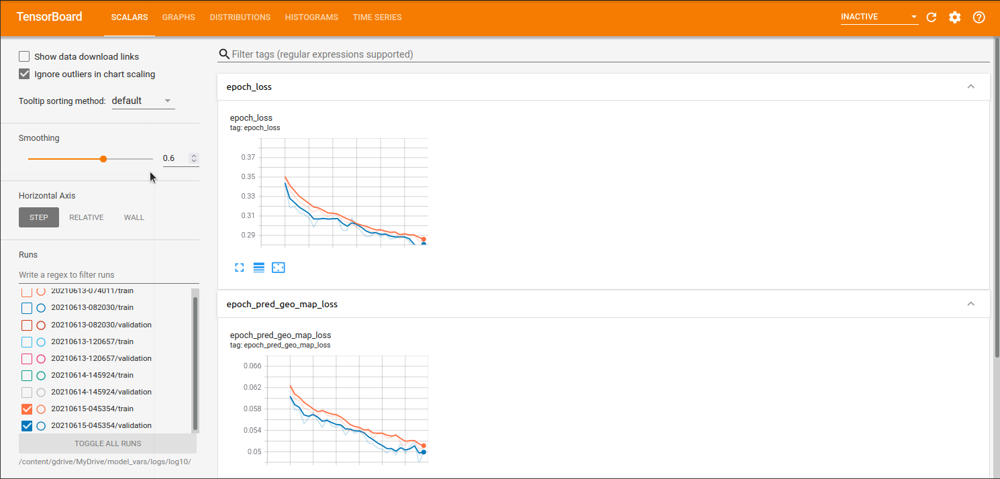

In [7]:
from IPython.display import Image
Image(filename='tb_2.png') 

In [179]:
losses=[]

In [187]:
from tensorflow.python.summary.summary_iterator import summary_iterator

for e in summary_iterator("/content/gdrive/MyDrive/model_vars/logs/log10/20210615-045354/train/events.out.tfevents.1623888773.0b185e262d1b.60.45736.v2"):
    for v in e.summary.value:
        if v.tag == 'epoch_loss' or v.tag == 'accuracy':
            losses.append(v.simple_value)

In [188]:
print(len(losses))

36


In [197]:
test_losses=[]

In [203]:

for e in summary_iterator("/content/gdrive/MyDrive/model_vars/logs/log10/20210615-045354/validation/events.out.tfevents.1623891173.0b185e262d1b.60.46377.v2"):
    for v in e.summary.value:
        if v.tag == 'epoch_loss' or v.tag == 'accuracy':
            test_losses.append(v.simple_value)


In [204]:
print(len(test_losses))

36


### Now we will create a function for generating a text predicted (bounded by box) image.

In [255]:
# image should be given as input after reading i.e. as image data or image array
def final_fun_1(image):
    img_resized, (ratio_h, ratio_w) = resize_image_1(image)
    img_resized = (img_resized / 127.5) - 1

    # feed image into model
    score_map, geo_map = final_model.model.predict(img_resized[np.newaxis, :, :, :])
    boxes = detect(score_map=score_map, geo_map=geo_map, nms_thres=0.08, box_thresh=0.1, score_map_thresh=0.6)

    if boxes is not None:
        boxes = boxes[:, :8].reshape((-1, 4, 2))
        boxes[:, :, 0] /= ratio_w
        boxes[:, :, 1] /= ratio_h

        for box in boxes:
            # to avoid submitting errors/ very small boxes  
            box = sort_poly(box.astype(np.int32))
            if np.linalg.norm(box[0] - box[1]) < 10 or np.linalg.norm(box[3]-box[0]) < 10:
                continue
            image=cv2.polylines(image, [box.astype(np.int32).reshape((-1, 1, 2))], True, color=(255, 0, 0), thickness=1)

    return image

def display_img(raw_image):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image) 
    plt.show()

In [262]:

#testing final method
#read an arbitrary imge from any path and provide to final func.
img = cv2.imread(base_dir+'img_data/SynthText/'+im_data['imnames'].values[74])[:, :, ::-1]
imga=img.copy()

eval_image= final_fun_1(imga)

402 600
86 text boxes before nms


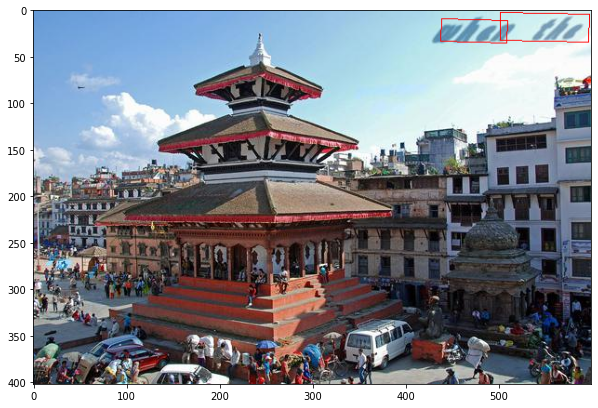

In [263]:
display_img(eval_image)


### Let us evaluate some Test images randomly and check how well our trained model is detecting text in them.

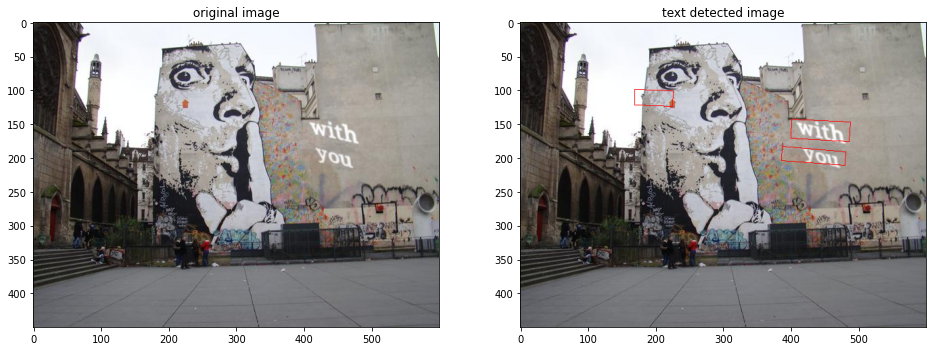

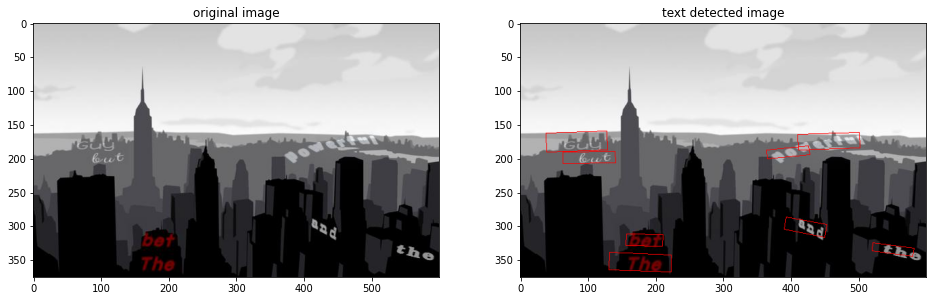

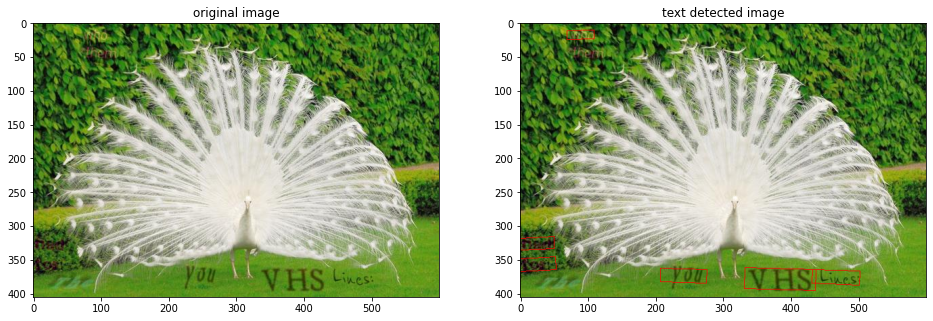

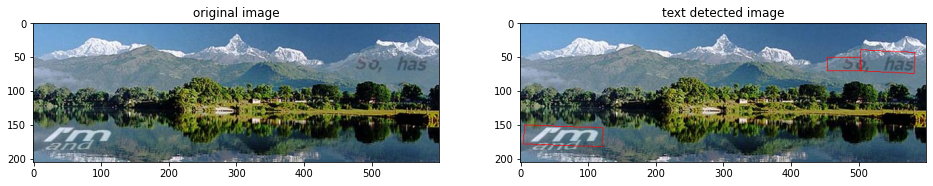

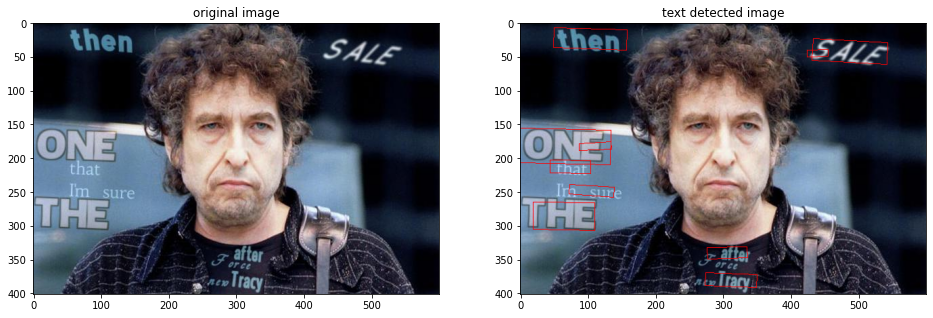

In [270]:
import random

indexes=[74,668,92,684,532]
for i in indexes:
    fig=plt.figure(figsize=(16,16))

    img = cv2.imread(base_dir+'img_data/SynthText/'+data_test['imnames'].values[i])[:, :, ::-1]
    imga=img.copy()#arguments in python are passed by reference
    eval_image= final_fun_1(imga)


    ax1 = fig.add_subplot(2,2,1)
    ax1.set_title('original image')
    ax1.imshow(img)
    ax2 = fig.add_subplot(2,2,2)
    ax2.set_title('text detected image')
    ax2.imshow(eval_image)
    plt.show()

  
  

### As we can see above, in Test images also the model performs very well given limited training and resources.

### Analysis of model results

##### we will check how the losses are wrt number of epochs in training.


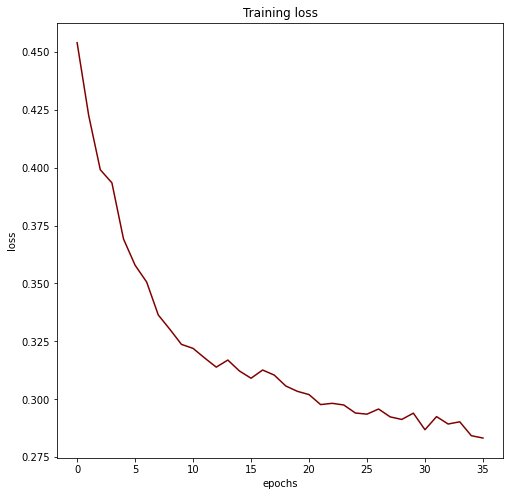

In [273]:
plt.figure(figsize=(8,8))
plt.title('Training loss')
plt.xlabel('epochs')
plt.ylabel('loss')
plt.plot(losses, color='maroon')

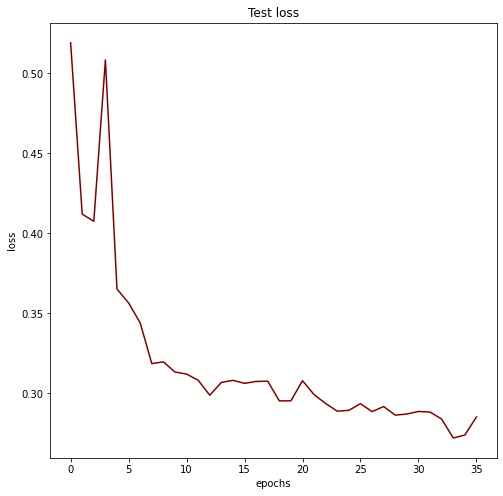

In [274]:
plt.figure(figsize=(8,8))
plt.title('Test loss')
plt.xlabel('epochs')
plt.ylabel('loss')
plt.plot(test_losses, color='maroon')

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'pdf for training loss')

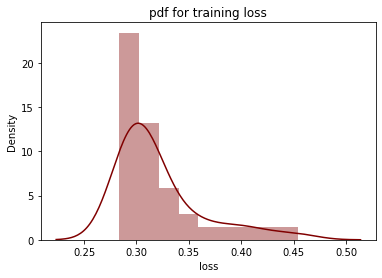

In [275]:
import seaborn as sns
ax = sns.distplot(losses,  color='maroon')
ax.set_xlabel('loss')
ax.set_title('pdf for training loss')

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'pdf for test loss')

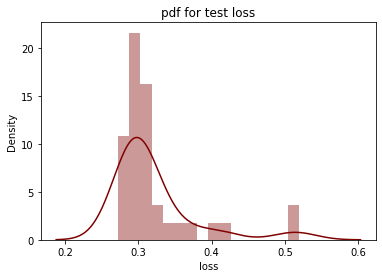

In [276]:
ax = sns.distplot(test_losses, color='maroon')
ax.set_xlabel('loss')
ax.set_title('pdf for test loss')

### Categorizing results

In [280]:
#for train
train_best = [loss for loss in losses if loss < np.percentile(losses, 33)] #----->Threshold-1
train_Average = [loss for loss in losses if np.percentile(losses, 33) < loss < np.percentile(losses, 75)]
train_Worst = [loss for loss in losses if loss > np.percentile(losses, 75)]

#### let's analyze how data is distributed with best being in top 33 percentile of training loss

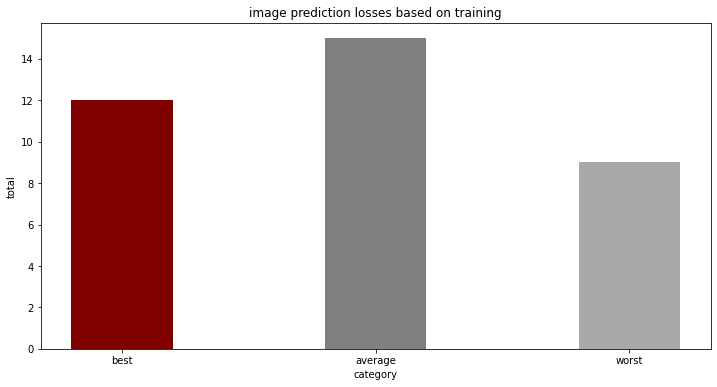

In [281]:
#bar plot
train_loss_data= {'best':len(train_best), 'average':len(train_Average), 'worst':len(train_Worst)}
category = list(train_loss_data.keys())
total = list(train_loss_data.values())
  
fig = plt.figure(figsize = (12, 6))
 
# creating the bar plot
clrs = ['maroon' if x=='best' else 'grey' if  x=='average' else 'darkgray' for x in category]
plt.bar(category, total,color= clrs,
        width = 0.4)
 
plt.xlabel("category")
plt.ylabel("total")
plt.title("image prediction losses based on training")
plt.show()

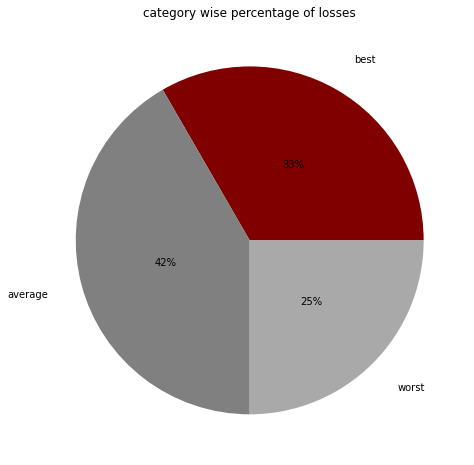

In [282]:
# pie chart
#https://stackoverflow.com/a/21580755
plt.figure(figsize=(12,8))
plt.title('category wise percentage of losses')
plt.pie(total, labels = category,autopct='%1.0f%%', pctdistance=0.5, labeldistance=1.2, colors=clrs)
plt.show() 

### Similarily we will do for test data

In [283]:
#for train
test_best = [loss for loss in test_losses if loss < np.percentile(losses, 33)] #----->Threshold-1
test_Average = [loss for loss in test_losses if np.percentile(losses, 33)< loss < np.percentile(losses, 75)]
test_Worst = [loss for loss in test_losses if loss > np.percentile(losses, 75)]

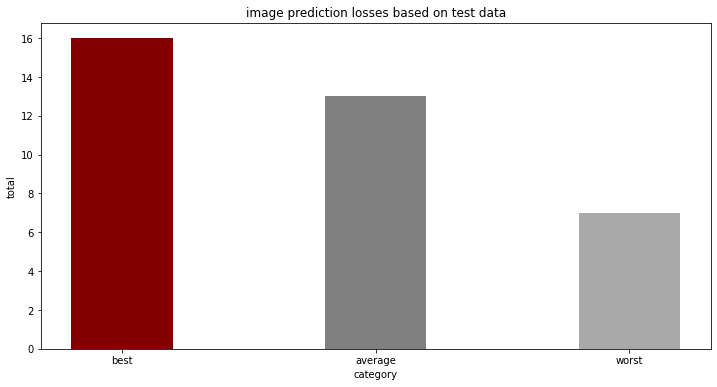

In [284]:
#bar plot
#
test_loss_data= {'best':len(test_best), 'average':len(test_Average), 'worst':len(test_Worst)}
category = list(test_loss_data.keys())
total = list(test_loss_data.values())
  
fig = plt.figure(figsize = (12, 6))
 
# creating the bar plot
#https://stackoverflow.com/questions/62607663/black-white-gray-bar-charts-in-python
clrs = ['maroon' if x=='best' else 'grey' if  x=='average' else 'darkgray' for x in category]
plt.bar(category, total,color= clrs,
        width = 0.4)
 
plt.xlabel("category")
plt.ylabel("total")
plt.title("image prediction losses based on test data")
plt.show()

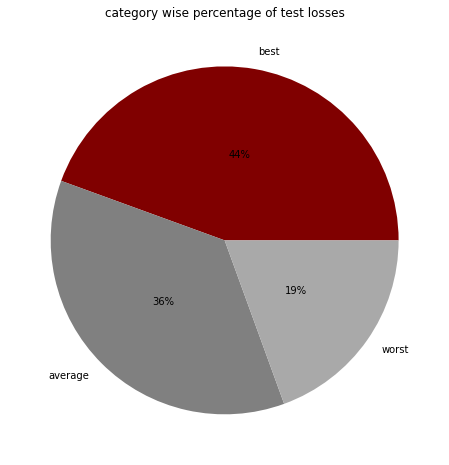

In [285]:
#pie chart 
#https://stackoverflow.com/a/21580755
plt.figure(figsize=(8,8))
plt.title('category wise percentage of test losses')

plt.pie(total, labels = category,autopct='%1.0f%%', pctdistance=0.5, labeldistance=1.1, colors=clrs)
plt.show() 

### As we can see in above plots for test losses, our model is performing better on test data.

##### We can infer in bar plot of test data that around 44% of data is from best category, 36% average and only around 19% from worst.

##### From these observations we can conclude that our model is performing well on test images.

### Model Quantization

##### Quantization refers to techniques for performing computations and storing tensors at lower bitwidths than floating point precision

In [97]:
#save model
final_model.model.save('/content/gdrive/MyDrive/saved_model.h5')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


In [98]:
print("model in Mb:", os.path.getsize('/content/gdrive/MyDrive/saved_model.h5') / float(2**20))

model in Mb: 278.0773391723633


In [94]:
#Post-training quantization
#https://www.tensorflow.org/lite/performance/post_training_quantization#float16_quantization

In [155]:
# Dynamic range quantization
# dynamic quantized tflite model is slower to infer but is of less 4x less size
#https://github.com/tensorflow/tensorflow/issues/4434
converter = tf.lite.TFLiteConverter.from_keras_model(final_model.model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]

tflite_quant_model_dynamic = converter.convert()

# Save the model.
with open('/content/gdrive/MyDrive/tflite_quant_model_dynamic.tflite', 'wb') as f:
    f.write(tflite_quant_model_dynamic)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /tmp/tmpgs_7wlya/assets


INFO:tensorflow:Assets written to: /tmp/tmpgs_7wlya/assets


In [156]:
print("dynamic model in Mb:", os.path.getsize('/content/gdrive/MyDrive/tflite_quant_model_dynamic.tflite') / float(2**20))

dynamic model in Mb: 23.66070556640625


In [144]:
#Float16 quantization
converter = tf.lite.TFLiteConverter.from_keras_model(final_model.model)
tflite_quant_model_Float = converter.convert()

# Save the model.
with open('/content/gdrive/MyDrive/tflite_quant_model_Float.tflite', 'wb') as f:
    f.write(tflite_quant_model_Float)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /tmp/tmpt79hhqry/assets


INFO:tensorflow:Assets written to: /tmp/tmpt79hhqry/assets


In [146]:
print("Float model in Mb:", os.path.getsize('/content/gdrive/MyDrive/tflite_quant_model_Float.tflite') / float(2**20))

Float model in Mb: 92.09735488891602


In [147]:
import os
#model quantization keras
#https://www.tensorflow.org/model_optimization/guide/quantization/training_example
print("Float model in Mb:", os.path.getsize('/content/gdrive/MyDrive/tflite_quant_model_Float.tflite') / float(2**20))
print("Quantized model in Mb:", os.path.getsize('/content/gdrive/MyDrive/tflite_quant_model_dynamic.tflite') / float(2**20))


Float model in Mb: 92.09735488891602
Quantized model in Mb: 23.66070556640625


#### As we can see quantized models are very less in size, which enables us to use it on limited memory devices such as IOT devices, mobile phones, cameras etc.

In [148]:
import numpy as np
import tensorflow as tf

# Load TFLite model and allocate tensors.
interpreter = tf.lite.Interpreter(model_path="/content/gdrive/MyDrive/tflite_quant_model_Float.tflite")

# Get input and output tensors.
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

interpreter.allocate_tensors()

# input details
print(input_details)
# output details
print(output_details)

[{'name': 'input_image', 'index': 0, 'shape': array([1, 1, 1, 3], dtype=int32), 'shape_signature': array([-1, -1, -1,  3], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}]
[{'name': 'Identity', 'index': 240, 'shape': array([1, 1, 1, 1], dtype=int32), 'shape_signature': array([-1, -1, -1,  1], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}, {'name': 'Identity_1', 'index': 249, 'shape': array([1, 1, 1, 5], dtype=int32), 'shape_signature': array([-1, -1, -1,  5], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype

### Inference on TFlite model

In [164]:
def final_fun_tflite(image,lite_type):
    img_resized, (ratio_h, ratio_w) = resize_image_1(image)
    img_resized = (img_resized / 127.5) - 1
    img_resized = img_resized[np.newaxis, :, :, :].astype('float32')

    # Load TFLite model and allocate tensors.
    if lite_type=='dynamic':
    interpreter = tf.lite.Interpreter(model_path="/content/gdrive/MyDrive/tflite_quant_model_dynamic.tflite")
    else:
    interpreter = tf.lite.Interpreter(model_path="/content/gdrive/MyDrive/tflite_quant_model_Float.tflite")
    ## Very very Important
    #https://stackoverflow.com/a/54584479
    #
    interpreter.resize_tensor_input(0, np.array(img_resized.shape))

    interpreter.allocate_tensors()

    # Get input and output tensors.
    input_details = interpreter.get_input_details()
    output_details = interpreter.get_output_details()
    # Test model on random input data.
    input_shape = input_details[0]['shape']

    interpreter.set_tensor(input_details[0]['index'], img_resized)

    interpreter.invoke()

    # The function `get_tensor()` returns a copy of the tensor data.
    # Use `tensor()` in order to get a pointer to the tensor.
    score_map = interpreter.get_tensor(output_details[0]['index']) #1st output
    geo_map = interpreter.get_tensor(output_details[1]['index']) #2nd output

    # feed image into model
    #score_map, geo_map = final_model.model.predict(img_resized[np.newaxis, :, :, :])
    boxes = detect(score_map=score_map, geo_map=geo_map, nms_thres=0.08, box_thresh=0.1, score_map_thresh=0.6)

    if boxes is not None:
        boxes = boxes[:, :8].reshape((-1, 4, 2))
        boxes[:, :, 0] /= ratio_w
        boxes[:, :, 1] /= ratio_h

        for box in boxes:
        # to avoid submitting errors/ very small boxes  
            box = sort_poly(box.astype(np.int32))
            if np.linalg.norm(box[0] - box[1]) < 10 or np.linalg.norm(box[3]-box[0]) < 10:
                continue
            image=cv2.polylines(image, [box.astype(np.int32).reshape((-1, 1, 2))], True, color=(0, 255, 0), thickness=2)

    return image

(720, 1280, 3)
input shape [   1  704 1280    3]


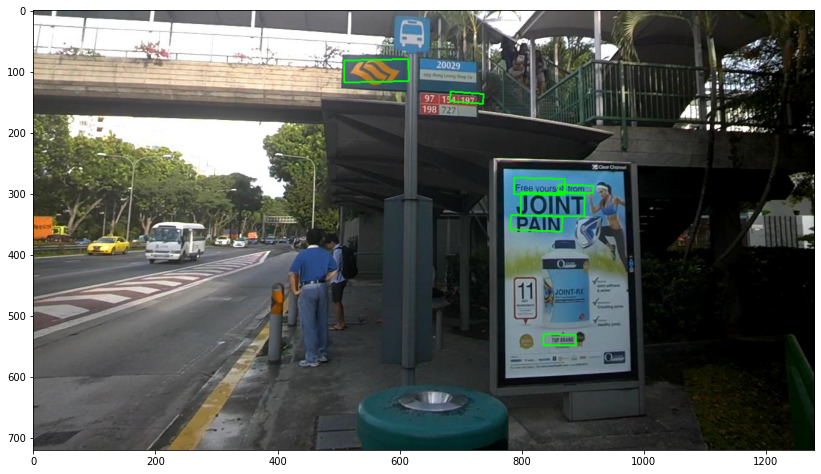

In [159]:
# this text detection inference is done from quantized model
#testing final method 
#read an arbitrary imge from icdar dataset( not included in train or test data of synthtext) and provide to final func.
img = cv2.imread(base_dir+'img_data/img_2.jpg')[:, :, ::-1]
imga=img.copy()
print(imga.shape)
eval_image= final_fun_tflite(imga,'dynamic')
display_img(eval_image)

### Final inference of keras and tflite models

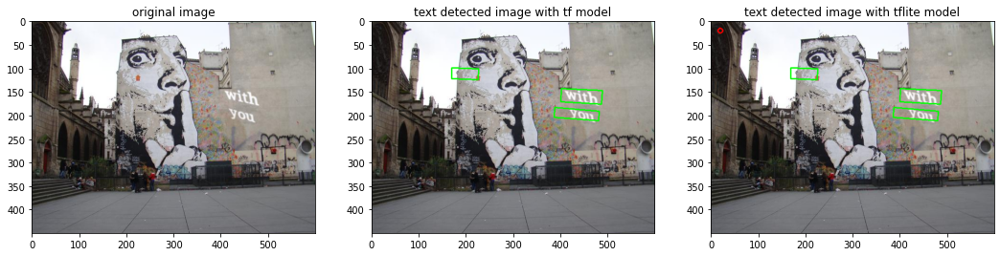

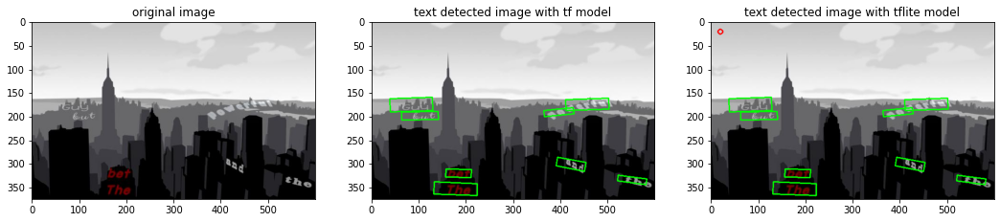

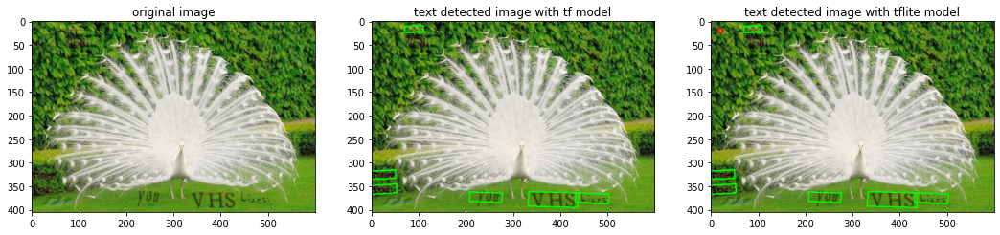

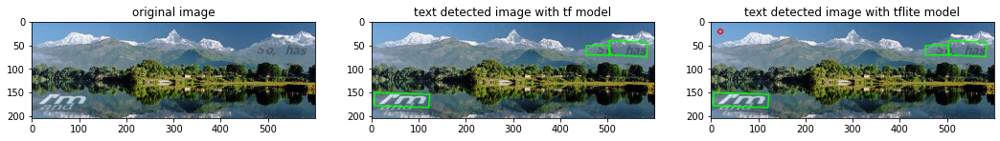

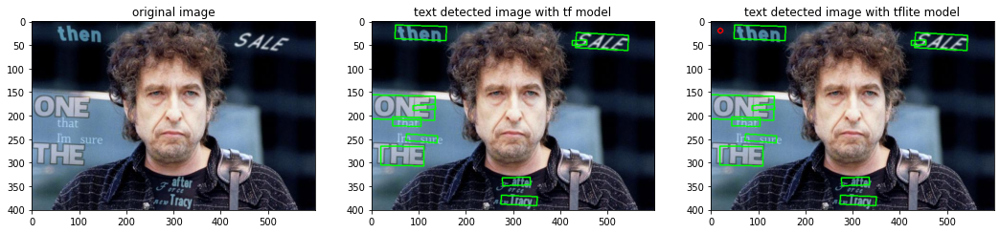

In [165]:
import random

indexes=[74,668,92,684,532]
for i in indexes:
    fig=plt.figure(figsize=(18,18))

    img = cv2.imread(base_dir+'img_data/SynthText/'+data_test['imnames'].values[i])[:, :, ::-1]
    imga=img.copy()#arguments in python are passed by reference
    eval_image= final_fun_1(imga)
    imga=img.copy()
    eval_image_quant= final_fun_tflite(imga, 'float')
    # keeping a red circle on top left of tflite model's image to ensure that keras image is not copied due to pass by ref.
    eval_image_quant = cv2.circle(eval_image_quant, (20,20), 5, color=(255,0,0), thickness= 2)

    ax1 = fig.add_subplot(3,3,1)
    ax1.set_title('original image')
    ax1.imshow(img)
    ax2 = fig.add_subplot(3,3,2)
    ax2.set_title('text detected image with tf model')
    ax2.imshow(eval_image)

    ax3 = fig.add_subplot(3,3,3)
    ax3.set_title('text detected image with tflite model')
    ax3.imshow(eval_image_quant)
    plt.show()


#### As we can see quantized models are very less in size, which enables us to use it on limited memory devices such as IOT devices, mobile phones, cameras etc.